# Loading Required Packages

In [1]:
from fish_helpers import *
from cellpose import models

# Dataset + Position

In [2]:
base_path = '/bigstore/Images2021/Zach/dredFISH/DPNMF+HV_2021Oct28/'
image_metadata = Metadata(base_path)
hybes = np.array([i for i in image_metadata.acqnames if 'hybe' in i])
posnames = np.unique(image_metadata.image_table[image_metadata.image_table.acq==hybes[0]].Position)
posname = posnames[0]

# Config

In [11]:
bitmap = [('RS0109_cy5', 'hybe2', 'FarRed'),
         ('RS0175_cy5', 'hybe3', 'FarRed'),
         ('RS0237_cy5', 'hybe4', 'FarRed'),
         ('RS0307_cy5', 'hybe5', 'FarRed'),
         ('RS0332_cy5', 'hybe6', 'FarRed'),
         ('RS0384_atto565', 'hybe10', 'FarRed'),
         ('RS0406_atto565', 'hybe11', 'FarRed'),
         ('RS0451_atto565', 'hybe12', 'FarRed'),
         ('RS0468_atto565', 'hybe13', 'FarRed'),
         ('RS0548_atto565', 'hybe14', 'FarRed'),
         ('RS64.0_atto565', 'hybe15', 'FarRed'),
         ('RS156.0_alexa488', 'hybe19', 'FarRed'),
         ('RS278.0_alexa488', 'hybe20', 'FarRed'),
         ('RS313.0_alexa488', 'hybe21', 'FarRed'),
         ('RS643.0_alexa488', 'hybe22', 'FarRed'),
         ('RS740.0_alexa488', 'hybe23', 'FarRed'),
         ('RS810.0_alexa488', 'hybe24', 'FarRed'),
         ('RSN9927.0_cy5', 'hybe7', 'FarRed'),
         ('RSN2336.0_cy5', 'hybe8', 'FarRed'),
         ('RSN1807.0_cy5', 'hybe9', 'FarRed'),
         ('RSN4287.0_atto565', 'hybe16', 'FarRed'),
         ('RSN1252.0_atto565', 'hybe17', 'FarRed'),
         ('RSN9535.0_atto565', 'hybe18', 'FarRed'),
              ('RS0095_cy5', 'hybe1', 'FarRed')]

In [18]:
pixel_size = 0.326

# Loading Raw Data

In [17]:
posname = posnames[10]
nucstain = np.array([i for i in image_metadata.acqnames if 'nucstain' in i])[-1]
nucstain_image = image_metadata.stkread(Position=posname,Channel='DeepBlue',acq=nucstain).mean(2).astype(float)
raw_dict = {hybe.split('_')[0]:image_metadata.stkread(Position=posname,Channel='FarRed',acq=hybe).mean(2).astype(float) for hybe in image_metadata.acqnames if 'hybe' in hybe}
background_dict = {'hybe'+strip.split('strip')[1].split('_')[0]:image_metadata.stkread(Position=posname,Channel='FarRed',acq=strip).mean(2).astype(float) for strip in image_metadata.acqnames if 'strip' in strip}
signal_dict = {hybe:raw_dict[hybe]-background_dict[hybe] for readout,hybe,channel in bitmap}
cytoplasm_image = np.dstack([signal_dict[hybe] for readout,hybe,channel in bitmap]).mean(2)

# Nuclear Segmentation

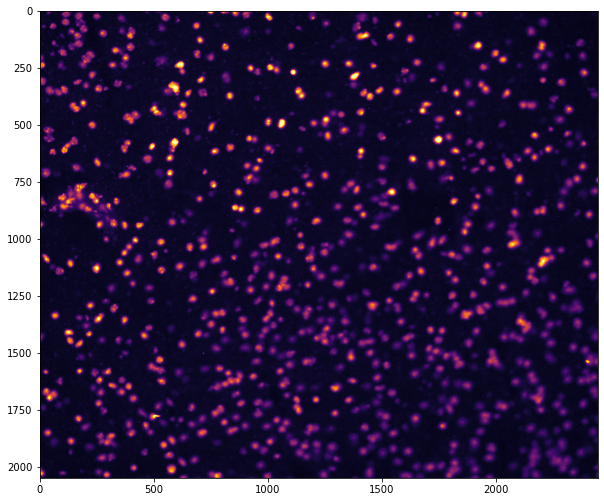

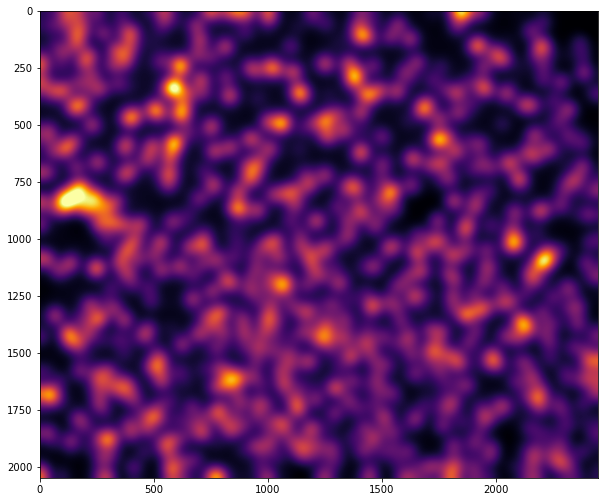

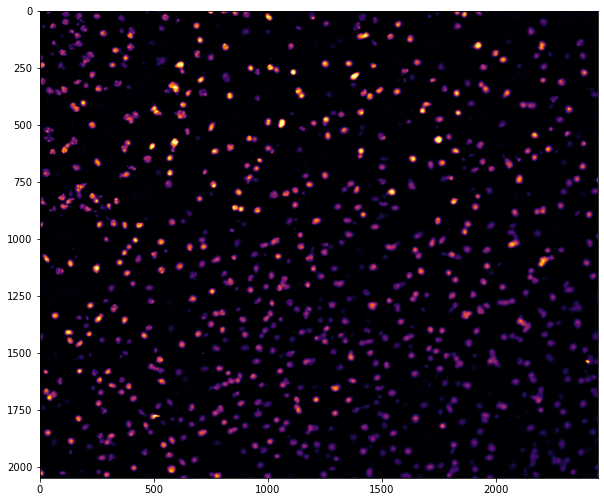

2021-11-15 16:30:54,490 [INFO] >>>> using CPU
2021-11-15 16:30:54,626 [INFO] ~~~ FINDING MASKS ~~~
2021-11-15 16:31:43,179 [INFO] >>>> TOTAL TIME 48.55 sec


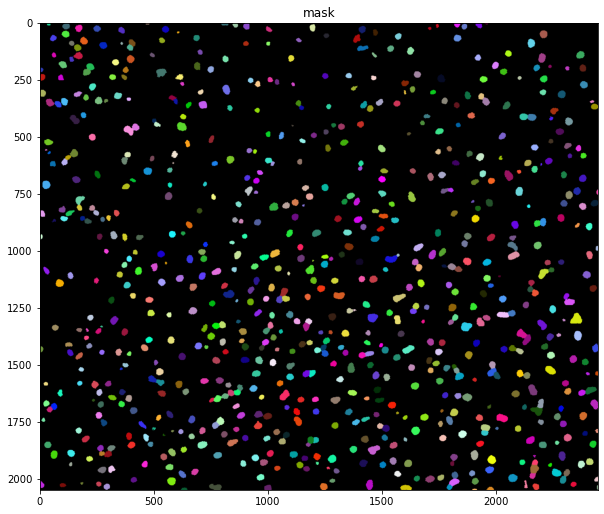

In [27]:
image = nucstain_image.copy()
""" Raw Image"""
Display(image)

""" Process Image """
bkg = gaussian_filter(image,10/pixel_size)
Display(bkg)
image = image-bkg
image[image<0] = 0
Display(image)
""" Segment Image """
model = models.Cellpose(model_type='nuclei',gpu=False)
raw_mask_image,flows,styles,diams = model.eval(image,
                                  diameter=10/pixel_size,
                                  channels=[0,0],
                                  flow_threshold=1,
                                  cellprob_threshold=0)
nuclei_mask = raw_mask_image
Display_mask(raw_mask_image)

# Cytoplasm Segmentation

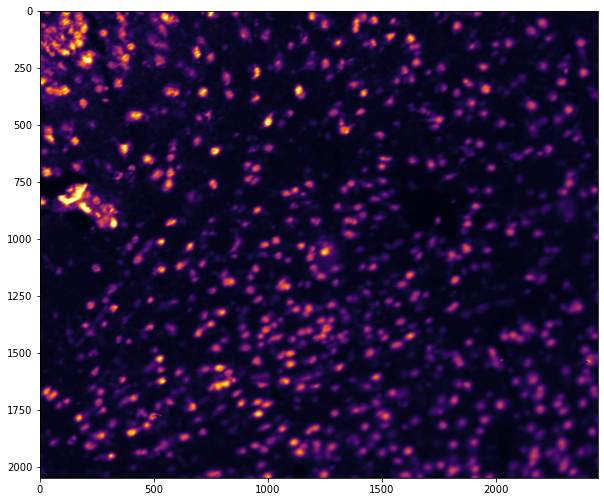

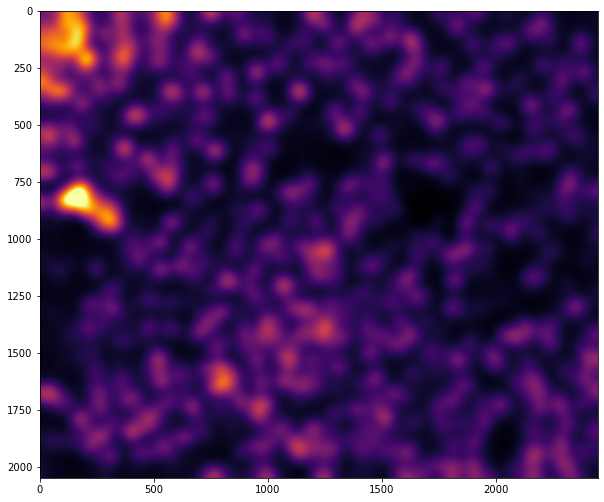

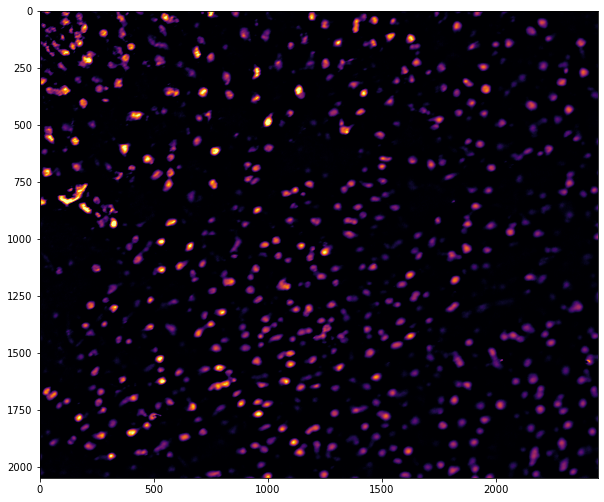

2021-11-15 16:20:49,989 [INFO] >>>> using CPU
2021-11-15 16:20:50,121 [INFO] ~~~ FINDING MASKS ~~~
2021-11-15 16:22:53,865 [INFO] >>>> TOTAL TIME 123.74 sec


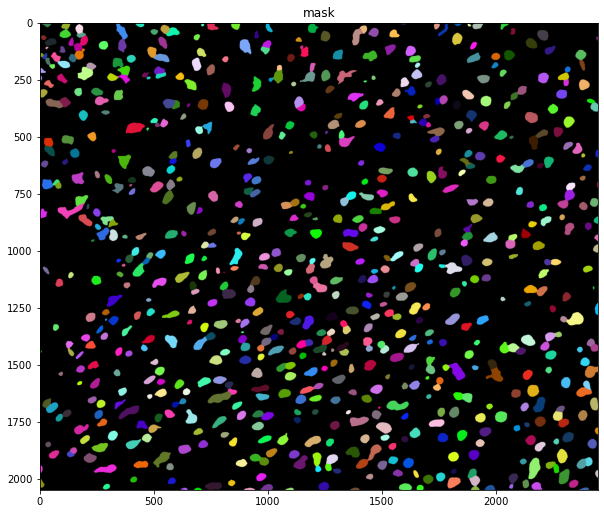

In [23]:
image = cytoplasm_image.copy()
""" Raw Image"""
Display(image)

""" Process Image """
bkg = gaussian_filter(image,10/pixel_size)
Display(bkg)
image = image-bkg
image[image<0] = 0
Display(image)
""" Segment Image """
model = models.Cellpose(model_type='cyto',gpu=False)
raw_mask_image,flows,styles,diams = model.eval(image,
                                  diameter=10/pixel_size,
                                  channels=[0,0],
                                  flow_threshold=1,
                                  cellprob_threshold=0)
Display_mask(raw_mask_image)

# Cytoplasm w/ Nuclei Segmentation

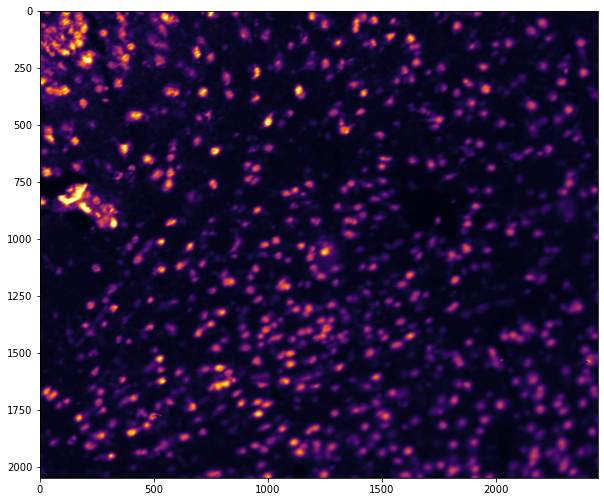

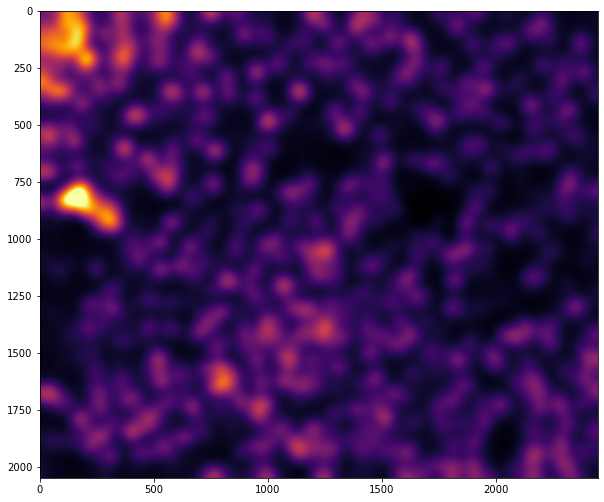

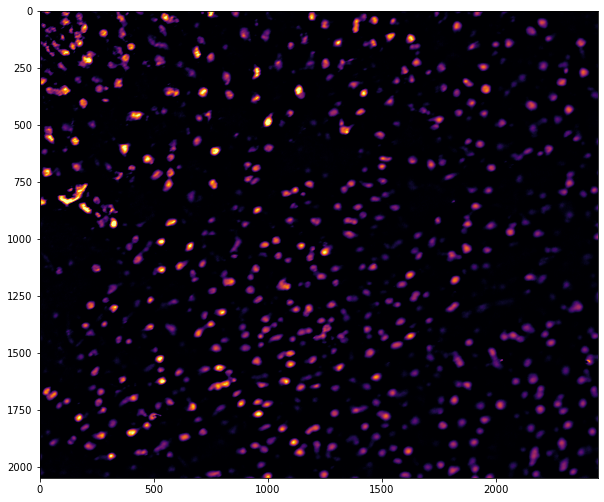

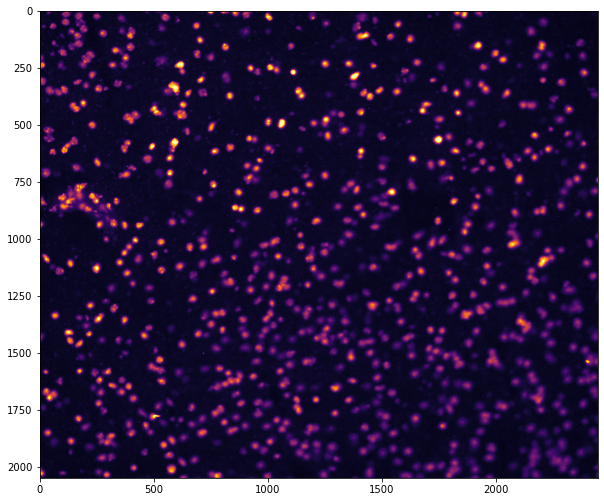

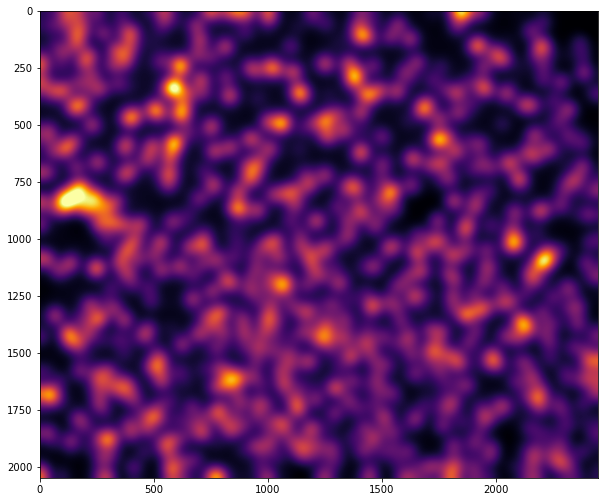

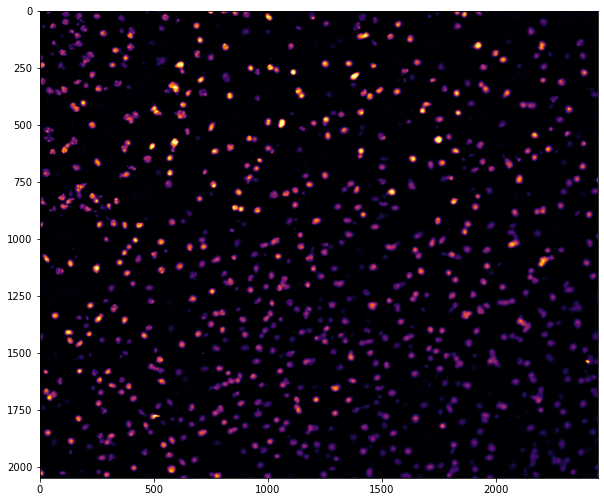

2021-11-15 16:31:55,890 [INFO] >>>> using CPU
2021-11-15 16:31:56,025 [INFO] ~~~ FINDING MASKS ~~~
2021-11-15 16:34:03,054 [INFO] >>>> TOTAL TIME 127.03 sec


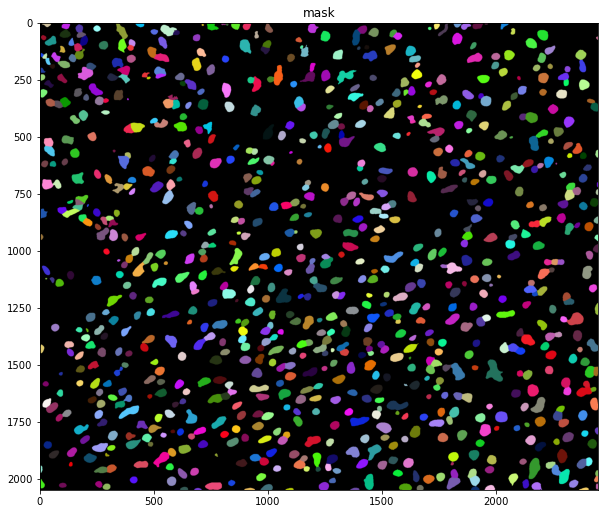

In [28]:
stk = np.dstack([cytoplasm_image.copy(),nucstain_image.copy(),np.zeros_like(cytoplasm_image.copy())])
""" Raw Image"""
image = cytoplasm_image.copy()
Display(image)

""" Process Image """
bkg = gaussian_filter(image,10/pixel_size)
Display(bkg)
image = image-bkg
image[image<0] = 0
Display(image)
stk[:,:,0] = image

""" Raw Image"""
image = nucstain_image.copy()
Display(image)

""" Process Image """
bkg = gaussian_filter(image,10/pixel_size)
Display(bkg)
image = image-bkg
image[image<0] = 0
Display(image)
stk[:,:,1] = image

""" Segment Image """
model = models.Cellpose(model_type='cyto',gpu=False)
raw_mask_image,flows,styles,diams = model.eval(stk,
                                  diameter=10/pixel_size,
                                  channels=[1,2],
                                  flow_threshold=1,
                                  cellprob_threshold=0)
cytoplasm_mask = raw_mask_image
Display_mask(raw_mask_image)

# Align Nuclei and Cytoplasm labels

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 794/794 [00:05<00:00, 156.28it/s]


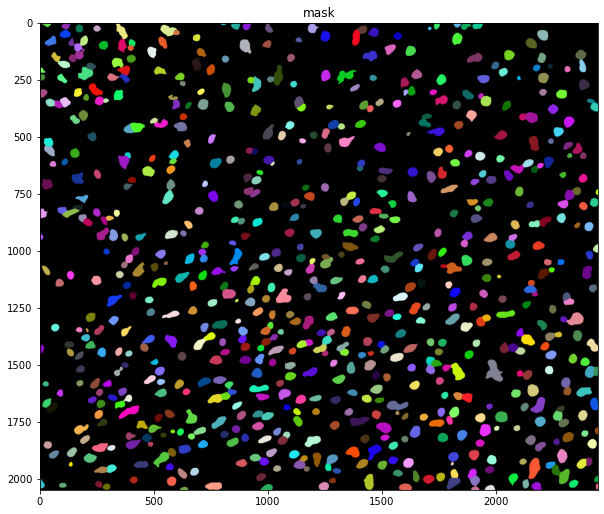

In [48]:
from scipy import stats
paired_nuclei_mask = nuclei_mask.copy()
labels = np.unique(nuclei_mask.ravel()[nuclei_mask.ravel()>0])
paired_cytoplasm_mask = np.zeros_like(cytoplasm_mask)
for label in tqdm(labels):
    m = nuclei_mask==label
    cyto_label = stats.mode(cytoplasm_mask[m]).mode[0]
    if cyto_label == 0:
        paired_nuclei_mask[m] = 0 # Eliminate Cell
        continue
    paired_cytoplasm_mask[cytoplasm_mask==cyto_label] = label
Display_mask(paired_cytoplasm_mask)

# Pulling Vectors

In [54]:
labels = np.unique(paired_nuclei_mask.ravel()[paired_nuclei_mask.ravel()>0])
nuclei_vectors = np.zeros([labels.shape[0],len(bitmap)])
cyto_vectors = np.zeros([labels.shape[0],len(bitmap)])
label_nuclei_coord_dict = {label:np.where(paired_nuclei_mask==label) for j,label in tqdm(enumerate(labels),total=labels.shape[0],desc='Generate Nuclei Coordinates')}
label_cyto_coord_dict = {label:np.where(paired_cytoplasm_mask==label) for j,label in tqdm(enumerate(labels),total=labels.shape[0],desc='Generate Cyto Coordinates')}
for i,(readout,hybe,channel) in enumerate(bitmap):
    image = signal_dict[hybe]
    for j,label in enumerate(labels):
        nuclei_vectors[j,i] = np.median(image[label_nuclei_coord_dict[label]])
        cyto_vectors[j,i] = np.median(image[label_cyto_coord_dict[label]])

Generate Label Coordinates: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 773/773 [00:17<00:00, 43.25it/s]


# Generate Cell Metadata

In [57]:
cell_metadata = []
for j,label in tqdm(enumerate(labels),total=labels.shape[0],desc=hybe):
    nx,ny = label_nuclei_coord_dict[label]
    cx,cy = label_cyto_coord_dict[label]
    data = [label,nx.shape[0],nx.mean(),ny.mean(),np.median(nucstain_image[nx,ny]),cx.shape[0],cx.mean(),cy.mean(),np.median(cytoplasm_image[cx,cy])]
    cell_metadata.append(pd.DataFrame(data,index=['label',
                          'nuclei_size',
                          'nuclei_x',
                          'nuclei_y',
                          'nuclei_signal',
                          'cyto_size',
                          'cyto_x',
                          'cyto_y',
                          'cyto_signal']).T)
cell_metadata = pd.concat(cell_metadata,ignore_index=True)

hybe1:  12%|███████████████████████▎                                                                                                                                                                        | 94/773 [00:00<00:00, 939.35it/s]/tmp/ipykernel_31743/2840806385.py:5: RuntimeWarning: Mean of empty slice.
  data = [int(label),nx.shape[0],nx.mean(),ny.mean(),np.median(nucstain_image[nx,ny]),cx.shape[0],cx.mean(),cy.mean(),np.median(cytoplasm_image[cx,cy])]
/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
hybe1: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

In [58]:
cell_metadata

,label,nuclei_size,nuclei_x,nuclei_y,nuclei_signal,cyto_size,cyto_x,cyto_y,cyto_signal
0,2.0,68.0,1.794118,1958.147059,4334.0,85.0,2.423529,1957.423529,286.666667
1,4.0,163.0,4.705521,37.846626,4286.0,482.0,6.599585,29.670124,2634.729167
2,5.0,330.0,4.675758,810.600000,4606.0,145.0,4.096552,803.972414,720.000000
3,6.0,424.0,7.985849,1829.622642,4742.0,526.0,7.859316,1830.893536,933.333333
4,7.0,397.0,8.740554,856.959698,4750.0,926.0,12.380130,858.053996,2069.041667
...,...,...,...,...,...,...,...,...,...
768,790.0,645.0,2037.131783,999.781395,4366.0,1036.0,2036.447876,997.407336,2961.083333
769,791.0,922.0,2037.363341,1605.114967,4270.0,1345.0,2034.539033,1603.028253,2245.375000
770,792.0,342.0,2041.552632,1975.649123,4190.0,765.0,2038.224837,1974.558170,1669.375000
771,793.0,249.0,2042.791165,632.441767,4366.0,400.0,2041.472500,632.477500,421.333333


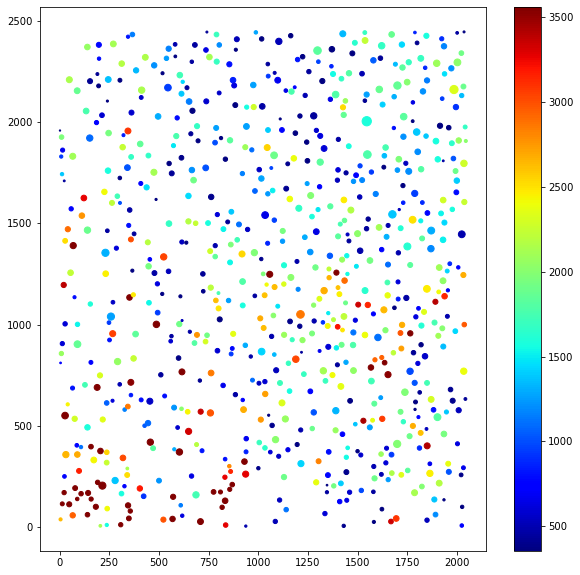

In [67]:
plt.figure(figsize=[10,10])
c = cell_metadata.cyto_signal
c[np.isnan(c)] = np.mean(c)
plt.scatter(cell_metadata.nuclei_x,cell_metadata.nuclei_y,s=cell_metadata.cyto_size/50,c=c,cmap='jet',vmin=np.percentile(c,5),vmax=np.percentile(c,95))
plt.colorbar()
plt.show()e

# Class

In [3]:
from MERFISH_Objects.FISHData import *
from datetime import datetime
from fish_helpers import *
from cellpose import models
import torch
class dredFISH_Position_Class(object):
    def __init__(self,
                 metadata_path,
                 dataset,
                 posname,
                 cword_config,
                 verbose=False):
        
        self.metadata_path = metadata_path
        self.dataset = dataset
        self.posname = posname
        self.cword_config = cword_config
        self.verbose = verbose
        self.proceed = True
        
        self.cword_config = cword_config
        self.merfish_config = importlib.import_module(self.cword_config)
        self.parameters = self.merfish_config.parameters
        self.fishdata = FISHData(os.path.join(self.metadata_path,self.parameters['fishdata']))
        self.bitmap = self.merfish_config.bitmap
        
        self.nucstain_acq = 'interpret'#self.parameters['nucstain_acq']
        self.total_acq = 'none'#self.parameters['total_acq']
        
    def run(self):
        self.check_data()
        if self.proceed:
            self.main()
    def update_user(self,message):
        i = [i for i in tqdm([],desc=str(datetime.now().strftime("%H:%M:%S"))+' '+str(message))]
        
    def main(self):
        if self.verbose:
            self.update_user('Processing Position '+self.posname)
        self.config_data()
        self.load_data()
        self.segmentation()
        if self.cell_metadata.shape[0]>0:
            self.pull_vectors()
            self.save_data()
        
    def check_data(self):
        if self.parameters['overwite']==False:
            self.data = self.fishdata.load_data('h5ad',dataset=self.dataset,posname=self.posname)
            if isinstance(self.data,type(None))==False:
                self.proceed==False
            self.nuclei_mask = self.fishdata.load_data('nuclei_mask',dataset=self.dataset,posname=self.posname)
            self.cytoplasm_mask = self.fishdata.load_data('cytoplasm_mask',dataset=self.dataset,posname=self.posname)
            self.total_mask = self.fishdata.load_data('total_mask',dataset=self.dataset,posname=self.posname)
        
    def config_data(self):
        if self.verbose:
            self.update_user('Loading Metadata')
        self.image_metadata = Metadata(self.metadata_path)
        
    def load_data(self):
        """ Load Nuclei Image """
        if self.verbose:
            self.update_user('Loading Nuclei Image')
        if self.nucstain_acq=='interpret':
            self.nucstain_acq = np.array([i for i in self.image_metadata.acqnames if 'nucstain' in i])[-1]
        self.nucstain_image = self.image_metadata.stkread(Position=posname,Channel=self.parameters['nucstain_channel'],acq=self.nucstain_acq).mean(2).astype(float)
        
        """ Load Raw Data """
        if self.verbose:
            self.update_user('Loading Raw Data')
        self.raw_dict = {hybe.split('_')[0]:torch.tensor(self.image_metadata.stkread(Position=self.posname,
                                                                        Channel=self.parameters['total_channel'],
                                                                        acq=hybe).mean(2).astype(float)) for hybe in self.image_metadata.acqnames if 'hybe' in hybe}
        self.background_dict = {'hybe'+strip.split('strip')[1].split('_')[0]:torch.tensor(self.image_metadata.stkread(Position=self.posname,
                                                                                                         Channel=self.parameters['total_channel'],
                                                                                                         acq=strip).mean(2).astype(float)) for strip in self.image_metadata.acqnames if 'strip' in strip}
        
        """ Subtract Background """
        if self.verbose:
            self.update_user('Subtracting Background')
        self.signal_dict = {hybe:self.raw_dict[hybe]-self.background_dict[hybe] for readout,hybe,channel in self.bitmap}
        
        """ Load Total Image """
        if self.verbose:
            self.update_user('Loading Total Image')
        if self.total_acq=='interpret':
            self.total_acq = np.array([i for i in self.image_metadata.acqnames if 'nucstain' in i])[-1]
            self.total_image = self.image_metadata.stkread(Position=self.posname,
                                                           Channel=self.parameters['total_channel'],
                                                           acq=self.total_acq).mean(2).astype(float)
        elif self.total_acq=='none':
            self.total_image = np.dstack([self.signal_dict[hybe] for readout,hybe,channel in self.bitmap]).mean(2)
        else:
            self.total_image = self.image_metadata.stkread(Position=self.posname,
                                                           Channel=self.parameters['total_channel'],
                                                           acq=self.total_acq).mean(2).astype(float)
            
    def process_image(self,image):
        bkg = gaussian_filter(image,self.parameters['segment_diameter']/self.parameters['segment_pixel_size'])
        image = image-bkg
        image[image<0] = 0
        return image
    
    def nuclei_segmentation(self):      
        """ Segment Image """
        if self.verbose:
            self.update_user('Segmenting Nuclei')
        torch.cuda.empty_cache() 
        model = models.Cellpose(model_type='nuclei',gpu=self.parameters['segment_gpu'])
        raw_mask_image,flows,styles,diams = model.eval(self.process_image(self.nucstain_image.copy()),
                                          diameter=self.parameters['segment_diameter']/self.parameters['segment_pixel_size'],
                                          channels=[0,0],
                                          flow_threshold=1,
                                          cellprob_threshold=0)
        self.nuclei_mask = torch.tensor(raw_mask_image.astype(int))
        del model,raw_mask_image,flows,styles,diams
        torch.cuda.empty_cache() 
        
    def total_segmentation(self):
        stk = np.dstack([self.process_image(self.total_image.copy()),self.process_image(self.nucstain_image.copy()),np.zeros_like(self.total_image.copy())])
        """ Segment Image """
        if self.verbose:
            self.update_user('Segmenting Total')
        torch.cuda.empty_cache() 
        model = models.Cellpose(model_type='cyto',gpu=self.parameters['segment_gpu'])
        raw_mask_image,flows,styles,diams = model.eval(stk,
                                          diameter=self.parameters['segment_diameter']/self.parameters['segment_pixel_size'],
                                          channels=[1,2],
                                          flow_threshold=1,
                                          cellprob_threshold=0)
        self.total_mask = torch.tensor(raw_mask_image.astype(int))
        del model,raw_mask_image,flows,styles,diams
        torch.cuda.empty_cache() 

    def generate_cell_metadata(self):
        if self.verbose:
            self.update_user('Generating Cell Metadata')
        labels = np.unique(self.nuclei_mask.ravel()[self.nuclei_mask.ravel()>0])
        self.label_nuclei_coord_dict = {label:torch.where(self.nuclei_mask==label) for j,label in enumerate(labels)}
        self.label_cyto_coord_dict = {label:torch.where((self.cytoplasm_mask==label)) for j,label in enumerate(labels)}
        self.label_total_coord_dict = {label:torch.where(self.total_mask==label) for j,label in enumerate(labels)}
        self.total_image = torch.tensor(self.total_image)
        if labels.shape[0]==0:
            self.cell_metadata = pd.DataFrame(index=['label','pixel_x','pixel_y','nuclei_size','nuclei_signal','cyto_size','cyto_signal','total_size','total_signal']).T
        else:
            cell_metadata = []
            for j,label in enumerate(labels):
                nx,ny = self.label_nuclei_coord_dict[label]
                cx,cy = self.label_cyto_coord_dict[label]
                tx,ty = self.label_total_coord_dict[label]
                label = label
                data = [float(label),float(nx.float().mean()),float(ny.float().mean()),
                        float(nx.shape[0]),float(torch.median(self.total_image[nx,ny])),
                        float(cx.shape[0]),float(torch.median(self.total_image[cx,cy])),
                        float(tx.shape[0]),float(torch.median(self.total_image[tx,ty]))]
                cell_metadata.append(pd.DataFrame(data,index=['label','pixel_x','pixel_y','nuclei_size','nuclei_signal','cyto_size','cyto_signal','total_size','total_signal']).T)
            self.cell_metadata = pd.concat(cell_metadata,ignore_index=True)
            self.cell_metadata['posname'] = self.posname
            position_x,position_y = self.image_metadata.image_table[self.image_metadata.image_table.Position==self.posname].XY.iloc[0]
            self.cell_metadata['posname_stage_x'] = position_x
            self.cell_metadata['posname_stage_y'] = position_y
        
    def segmentation(self):
        """ Segment """
        self.nuclei_segmentation()
        self.total_segmentation()
        
        """ Align Nuclei and Total Labels"""
        if self.verbose:
            self.update_user('Aligning Segmentation labels')
        from scipy import stats
        paired_nuclei_mask = torch.clone(self.nuclei_mask)
        labels = torch.unique(self.nuclei_mask.ravel()[self.nuclei_mask.ravel()>0])
        paired_total_mask = torch.zeros_like(self.total_mask)
        for label in labels:
            m = self.nuclei_mask==label
            cyto_label = stats.mode(self.total_mask[m]).mode[0]
            if cyto_label == 0:
                paired_nuclei_mask[m] = 0 # Eliminate Cell
                continue
            paired_total_mask[self.total_mask==cyto_label] = label
        self.nuclei_mask = paired_nuclei_mask
        self.total_mask = paired_total_mask
        self.cytoplasm_mask = torch.clone(paired_total_mask)
        self.cytoplasm_mask[self.nuclei_mask>0] = 0
        self.generate_cell_metadata()

    def pull_vectors(self):
        if self.verbose:
            self.update_user('Pulling Vectors')
        labels = torch.unique(self.nuclei_mask.ravel()[self.nuclei_mask.ravel()>0]).numpy()
        nuclei_vectors = torch.zeros([labels.shape[0],len(self.bitmap)])
        cyto_vectors = torch.zeros([labels.shape[0],len(self.bitmap)])
        total_vectors = torch.zeros([labels.shape[0],len(self.bitmap)])
        for i,(readout,hybe,channel) in enumerate(self.bitmap):
            image = self.signal_dict[hybe] # Alternatively Load Images Here maybe save on memory
            for j,label in enumerate(labels):
                nuclei_vectors[j,i] = torch.median(image[self.label_nuclei_coord_dict[label]])
                cyto_vectors[j,i] = torch.median(image[self.label_cyto_coord_dict[label]])
                total_vectors[j,i] = torch.median(image[self.label_total_coord_dict[label]])
        self.nuclei_vectors = nuclei_vectors
        self.cyto_vectors = cyto_vectors
        self.total_vectors = total_vectors
        
    def save_data(self):
        if self.verbose:
            self.update_user('Saving Data and Masks')
        data = anndata.AnnData(X=self.nuclei_vectors.numpy(),var=pd.DataFrame(index=np.array([h for r,h,c in self.bitmap])),obs=pd.DataFrame(index=self.cell_metadata.index.astype(str)))
        data.layers['nuclei_vectors'] = self.nuclei_vectors.numpy()
        data.layers['cytoplasm_vectors'] = self.cyto_vectors.numpy()
        data.layers['total_vectors'] = self.total_vectors.numpy()
        for column in self.cell_metadata.columns:
            data.obs[column] = np.array(self.cell_metadata[column])
        data.obs_names_make_unique()
        self.data = data
        self.fishdata.add_and_save_data(self.data,
                                        dtype='h5ad',
                                        dataset=self.dataset,
                                        posname=self.posname)
        self.fishdata.add_and_save_data(self.nuclei_mask.numpy(),
                                        dtype='nuclei_mask',
                                        dataset=self.dataset,
                                        posname=self.posname)
        self.fishdata.add_and_save_data(self.cytoplasm_mask.numpy(),
                                        dtype='cytoplasm_mask',
                                        dataset=self.dataset,
                                        posname=self.posname)
        self.fishdata.add_and_save_data(self.total_mask.numpy(),
                                        dtype='total_mask',
                                        dataset=self.dataset,
                                        posname=self.posname)


In [34]:
""" Test Out a Single Position """
metadata_path = '/bigstore/Images2021/Zach/dredFISH/DPNMF+HV_2021Oct28/'
if metadata_path[-1]=='/':
    dataset = metadata_path.split('/')[-2]
else:
    dataset = metadata_path.split('/')[-1]
posname = 'Pos108'
cword_config = 'dredfish_config'
import time
start = time.time()
print(str(datetime.now().strftime("%H:%M:%S")))

pos_class = dredFISH_Position_Class(metadata_path,dataset,posname,cword_config,verbose=True)
pos_class.main()
print(str(datetime.now().strftime("%H:%M:%S")))
print(time.time()-start)

14:06:22


14:06:22 Processing Position Pos108: 0it [00:00, ?it/s]
14:06:22 Loading Metadata: 0it [00:00, ?it/s]
14:06:24 Loading Nuclei Image: 0it [00:00, ?it/s]
14:06:24 Loading Raw Data: 0it [00:00, ?it/s]
14:06:28 Subtracting Background: 0it [00:00, ?it/s]
14:06:28 Loading Total Image: 0it [00:00, ?it/s]
14:06:30 Segmenting Nuclei: 0it [00:00, ?it/s]

2021-11-17 14:06:30,476 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 14:06:30,477 [INFO] >>>> using GPU


2021-11-17 14:06:32,629 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 14:06:39,104 [INFO] >>>> TOTAL TIME 6.47 sec


14:06:43 Segmenting Total: 0it [00:00, ?it/s]

2021-11-17 14:06:43,258 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 14:06:43,259 [INFO] >>>> using GPU
2021-11-17 14:06:43,403 [INFO] ~~~ FINDING MASKS ~~~


2021-11-17 14:07:05,492 [INFO] >>>> TOTAL TIME 22.09 sec


14:07:05 Aligning Segmentation labels: 0it [00:00, ?it/s]
14:07:09 Generating Cell Metadata: 0it [00:00, ?it/s]
14:07:12 Pulling Vectors: 0it [00:00, ?it/s]
14:07:16 Saving Data and Masks: 0it [00:00, ?it/s]
/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical


14:07:17
54.653499126434326


/tmp/ipykernel_5961/2930616272.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  c[np.isnan(c)] = np.mean(c)


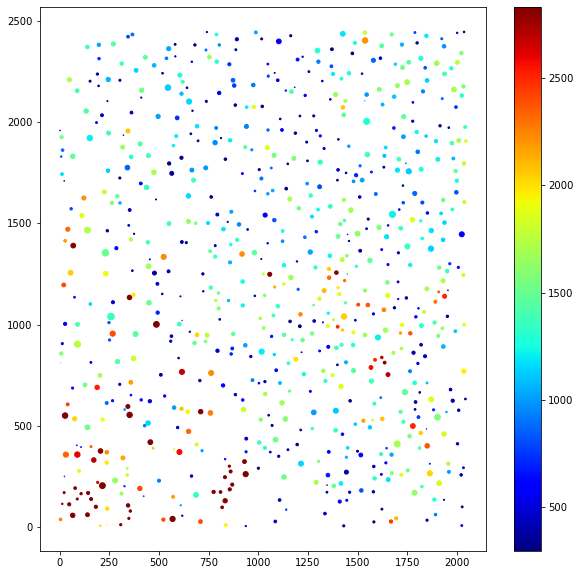

In [36]:
""" View Result """
plt.figure(figsize=[10,10])
c = pos_class.cell_metadata.total_signal
c[np.isnan(c)] = np.mean(c)
plt.scatter(pos_class.cell_metadata.pixel_x,pos_class.cell_metadata.pixel_y,s=pos_class.cell_metadata.total_size/50,c=c,cmap='jet',vmin=np.percentile(c,5),vmax=np.percentile(c,95))
plt.colorbar()
plt.show()

In [4]:
""" Simple For Loop 100 Positions in ~2 Hours """
metadata_path = '/bigstore/Images2021/Zach/dredFISH/DPNMF+HV_2021Oct28/'
if metadata_path[-1]=='/':
    dataset = metadata_path.split('/')[-2]
else:
    dataset = metadata_path.split('/')[-1]
cword_config = 'dredfish_config'
image_metadata = Metadata(metadata_path)
hybes = np.array([i for i in image_metadata.acqnames if 'hybe' in i])
posnames = np.unique(image_metadata.image_table[image_metadata.image_table.acq==hybes[0]].Position)
for posname in tqdm(posnames):
    pos_class = dredFISH_Position_Class(metadata_path,dataset,posname,cword_config,verbose=False)
    pos_class.main()

  0%|                                                                                                                                                                 | 0/124 [00:00<?, ?it/s]

2021-11-17 16:01:33,129 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:01:33,134 [INFO] >>>> using GPU
2021-11-17 16:01:35,346 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:01:40,605 [INFO] >>>> TOTAL TIME 5.26 sec
2021-11-17 16:01:44,875 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:01:44,877 [INFO] >>>> using GPU
2021-11-17 16:01:45,020 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:01:57,932 [INFO] >>>> TOTAL TIME 12.91 sec


  1%|█▏                                                                                                                                                     | 1/124 [00:42<1:26:56, 42.41s/it]

2021-11-17 16:02:11,368 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:02:11,371 [INFO] >>>> using GPU
2021-11-17 16:02:13,567 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:02:20,323 [INFO] >>>> TOTAL TIME 6.76 sec
2021-11-17 16:02:24,581 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:02:24,582 [INFO] >>>> using GPU
2021-11-17 16:02:24,727 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:02:44,757 [INFO] >>>> TOTAL TIME 20.03 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
  2%|██▍                                                                                                                                                    | 2/124 [01:40<1:45:33, 51.91s/it]

2021-11-17 16:03:10,282 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:03:10,294 [INFO] >>>> using GPU
2021-11-17 16:03:12,485 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:03:19,127 [INFO] >>>> TOTAL TIME 6.64 sec
2021-11-17 16:03:23,320 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:03:23,321 [INFO] >>>> using GPU
2021-11-17 16:03:23,464 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:03:42,324 [INFO] >>>> TOTAL TIME 18.86 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
  2%|███▋                                                                                                                                                   | 3/124 [02:38<1:49:54, 54.50s/it]

2021-11-17 16:04:09,199 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:04:09,202 [INFO] >>>> using GPU
2021-11-17 16:04:11,440 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:04:18,755 [INFO] >>>> TOTAL TIME 7.32 sec
2021-11-17 16:04:23,080 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:04:23,082 [INFO] >>>> using GPU
2021-11-17 16:04:23,229 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:04:44,749 [INFO] >>>> TOTAL TIME 21.52 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
  3%|████▊                                                                                                                                                  | 4/124 [03:42<1:56:35, 58.30s/it]

2021-11-17 16:05:14,236 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:05:14,239 [INFO] >>>> using GPU
2021-11-17 16:05:16,457 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:05:23,643 [INFO] >>>> TOTAL TIME 7.19 sec
2021-11-17 16:05:28,006 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:05:28,009 [INFO] >>>> using GPU
2021-11-17 16:05:28,155 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:05:47,948 [INFO] >>>> TOTAL TIME 19.79 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
  4%|██████                                                                                                                                                 | 5/124 [04:46<1:59:20, 60.17s/it]

2021-11-17 16:06:15,659 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:06:15,662 [INFO] >>>> using GPU
2021-11-17 16:06:17,865 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:06:24,859 [INFO] >>>> TOTAL TIME 6.99 sec
2021-11-17 16:06:29,092 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:06:29,095 [INFO] >>>> using GPU
2021-11-17 16:06:29,239 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:06:50,041 [INFO] >>>> TOTAL TIME 20.80 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
  5%|███████▎                                                                                                                                               | 6/124 [05:48<1:59:38, 60.83s/it]

2021-11-17 16:07:17,668 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:07:17,671 [INFO] >>>> using GPU
2021-11-17 16:07:19,859 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:07:26,999 [INFO] >>>> TOTAL TIME 7.14 sec
2021-11-17 16:07:31,270 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:07:31,272 [INFO] >>>> using GPU
2021-11-17 16:07:31,425 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:07:52,368 [INFO] >>>> TOTAL TIME 20.94 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
  6%|████████▌                                                                                                                                              | 7/124 [06:50<1:59:40, 61.37s/it]

2021-11-17 16:08:20,130 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:08:20,131 [INFO] >>>> using GPU
2021-11-17 16:08:22,312 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:08:29,079 [INFO] >>>> TOTAL TIME 6.77 sec
2021-11-17 16:08:33,338 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:08:33,340 [INFO] >>>> using GPU
2021-11-17 16:08:33,484 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:08:53,336 [INFO] >>>> TOTAL TIME 19.85 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
  6%|█████████▋                                                                                                                                             | 8/124 [07:50<1:57:31, 60.79s/it]

2021-11-17 16:09:19,370 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:09:19,373 [INFO] >>>> using GPU
2021-11-17 16:09:21,555 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:09:28,861 [INFO] >>>> TOTAL TIME 7.31 sec
2021-11-17 16:09:33,132 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:09:33,133 [INFO] >>>> using GPU
2021-11-17 16:09:33,276 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:09:55,392 [INFO] >>>> TOTAL TIME 22.12 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
  7%|██████████▉                                                                                                                                            | 9/124 [08:54<1:58:30, 61.83s/it]

2021-11-17 16:10:25,431 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:10:25,433 [INFO] >>>> using GPU
2021-11-17 16:10:27,639 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:10:34,746 [INFO] >>>> TOTAL TIME 7.11 sec
2021-11-17 16:10:39,007 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:10:39,008 [INFO] >>>> using GPU
2021-11-17 16:10:39,152 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:11:02,467 [INFO] >>>> TOTAL TIME 23.31 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
  8%|████████████                                                                                                                                          | 10/124 [10:03<2:01:26, 63.92s/it]

2021-11-17 16:11:34,412 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:11:34,415 [INFO] >>>> using GPU
2021-11-17 16:11:36,600 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:11:43,447 [INFO] >>>> TOTAL TIME 6.85 sec
2021-11-17 16:11:47,755 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:11:47,756 [INFO] >>>> using GPU
2021-11-17 16:11:47,899 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:12:10,172 [INFO] >>>> TOTAL TIME 22.27 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
  9%|█████████████▎                                                                                                                                        | 11/124 [11:06<1:59:54, 63.67s/it]

2021-11-17 16:12:37,662 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:12:37,665 [INFO] >>>> using GPU
2021-11-17 16:12:39,866 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:12:45,749 [INFO] >>>> TOTAL TIME 5.88 sec
2021-11-17 16:12:50,141 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:12:50,143 [INFO] >>>> using GPU
2021-11-17 16:12:50,301 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:13:08,560 [INFO] >>>> TOTAL TIME 18.26 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 10%|██████████████▌                                                                                                                                       | 12/124 [12:00<1:53:20, 60.72s/it]

2021-11-17 16:13:29,961 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:13:29,963 [INFO] >>>> using GPU
2021-11-17 16:13:32,145 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:13:39,431 [INFO] >>>> TOTAL TIME 7.29 sec
2021-11-17 16:13:43,604 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:13:43,605 [INFO] >>>> using GPU
2021-11-17 16:13:43,749 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:14:05,464 [INFO] >>>> TOTAL TIME 21.72 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 10%|███████████████▋                                                                                                                                      | 13/124 [13:04<1:54:13, 61.74s/it]

2021-11-17 16:14:35,141 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:14:35,143 [INFO] >>>> using GPU
2021-11-17 16:14:37,339 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:14:42,021 [INFO] >>>> TOTAL TIME 4.68 sec
2021-11-17 16:14:46,343 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:14:46,344 [INFO] >>>> using GPU
2021-11-17 16:14:46,487 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:14:58,543 [INFO] >>>> TOTAL TIME 12.06 sec


 11%|████████████████▉                                                                                                                                     | 14/124 [13:43<1:40:31, 54.83s/it]

2021-11-17 16:15:17,067 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:15:17,070 [INFO] >>>> using GPU
2021-11-17 16:15:19,263 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:15:23,963 [INFO] >>>> TOTAL TIME 4.70 sec
2021-11-17 16:15:28,245 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:15:28,246 [INFO] >>>> using GPU
2021-11-17 16:15:28,388 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:15:40,440 [INFO] >>>> TOTAL TIME 12.05 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 12%|██████████████████▏                                                                                                                                   | 15/124 [14:25<1:32:55, 51.15s/it]

2021-11-17 16:16:00,404 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:16:00,406 [INFO] >>>> using GPU
2021-11-17 16:16:02,628 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:16:07,606 [INFO] >>>> TOTAL TIME 4.98 sec
2021-11-17 16:16:11,952 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:16:11,953 [INFO] >>>> using GPU
2021-11-17 16:16:12,114 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:16:24,726 [INFO] >>>> TOTAL TIME 12.61 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 13%|███████████████████▎                                                                                                                                  | 16/124 [15:09<1:28:16, 49.04s/it]

2021-11-17 16:17:03,382 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:17:03,384 [INFO] >>>> using GPU
2021-11-17 16:17:05,606 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:17:10,413 [INFO] >>>> TOTAL TIME 4.81 sec
2021-11-17 16:17:14,710 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:17:14,712 [INFO] >>>> using GPU
2021-11-17 16:17:14,860 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:17:27,030 [INFO] >>>> TOTAL TIME 12.17 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 14%|████████████████████▌                                                                                                                                 | 17/124 [16:12<1:34:30, 52.99s/it]

2021-11-17 16:17:42,006 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:17:42,008 [INFO] >>>> using GPU
2021-11-17 16:17:44,196 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:17:49,467 [INFO] >>>> TOTAL TIME 5.27 sec
2021-11-17 16:17:53,747 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:17:53,748 [INFO] >>>> using GPU
2021-11-17 16:17:53,889 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:18:08,681 [INFO] >>>> TOTAL TIME 14.79 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 15%|█████████████████████▊                                                                                                                                | 18/124 [16:58<1:30:24, 51.18s/it]

2021-11-17 16:18:30,879 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:18:30,882 [INFO] >>>> using GPU
2021-11-17 16:18:33,113 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:18:38,815 [INFO] >>>> TOTAL TIME 5.70 sec
2021-11-17 16:18:43,173 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:18:43,174 [INFO] >>>> using GPU
2021-11-17 16:18:43,327 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:18:58,897 [INFO] >>>> TOTAL TIME 15.57 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 15%|██████████████████████▉                                                                                                                               | 19/124 [17:49<1:29:22, 51.07s/it]

2021-11-17 16:19:19,568 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:19:19,571 [INFO] >>>> using GPU
2021-11-17 16:19:21,752 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:19:27,441 [INFO] >>>> TOTAL TIME 5.69 sec
2021-11-17 16:19:31,740 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:19:31,743 [INFO] >>>> using GPU
2021-11-17 16:19:31,887 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:19:47,762 [INFO] >>>> TOTAL TIME 15.88 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 16%|████████████████████████▏                                                                                                                             | 20/124 [18:39<1:28:00, 50.78s/it]

2021-11-17 16:20:10,737 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:20:10,739 [INFO] >>>> using GPU
2021-11-17 16:20:12,995 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:20:19,177 [INFO] >>>> TOTAL TIME 6.18 sec
2021-11-17 16:20:23,466 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:20:23,468 [INFO] >>>> using GPU
2021-11-17 16:20:23,611 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:20:41,085 [INFO] >>>> TOTAL TIME 17.47 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 17%|█████████████████████████▍                                                                                                                            | 21/124 [19:34<1:29:06, 51.91s/it]

2021-11-17 16:21:05,906 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:21:05,909 [INFO] >>>> using GPU
2021-11-17 16:21:08,085 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:21:14,792 [INFO] >>>> TOTAL TIME 6.71 sec
2021-11-17 16:21:19,029 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:21:19,030 [INFO] >>>> using GPU
2021-11-17 16:21:19,171 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:21:40,370 [INFO] >>>> TOTAL TIME 21.20 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 18%|██████████████████████████▌                                                                                                                           | 22/124 [20:37<1:33:54, 55.24s/it]

2021-11-17 16:22:07,004 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:22:07,007 [INFO] >>>> using GPU
2021-11-17 16:22:09,231 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:22:15,772 [INFO] >>>> TOTAL TIME 6.54 sec
2021-11-17 16:22:20,109 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:22:20,111 [INFO] >>>> using GPU
2021-11-17 16:22:20,256 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:22:42,214 [INFO] >>>> TOTAL TIME 21.96 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 19%|███████████████████████████▊                                                                                                                          | 23/124 [21:37<1:35:29, 56.73s/it]

2021-11-17 16:23:07,661 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:23:07,664 [INFO] >>>> using GPU
2021-11-17 16:23:09,844 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:23:17,020 [INFO] >>>> TOTAL TIME 7.18 sec
2021-11-17 16:23:21,290 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:23:21,292 [INFO] >>>> using GPU
2021-11-17 16:23:21,434 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:23:43,600 [INFO] >>>> TOTAL TIME 22.17 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 19%|█████████████████████████████                                                                                                                         | 24/124 [22:42<1:38:41, 59.21s/it]

2021-11-17 16:24:11,362 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:24:11,365 [INFO] >>>> using GPU
2021-11-17 16:24:13,533 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:24:19,402 [INFO] >>>> TOTAL TIME 5.87 sec
2021-11-17 16:24:23,643 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:24:23,644 [INFO] >>>> using GPU
2021-11-17 16:24:23,786 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:24:42,142 [INFO] >>>> TOTAL TIME 18.36 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 20%|██████████████████████████████▏                                                                                                                       | 25/124 [23:34<1:34:03, 57.01s/it]

2021-11-17 16:25:02,620 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:25:02,621 [INFO] >>>> using GPU
2021-11-17 16:25:04,825 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:25:09,453 [INFO] >>>> TOTAL TIME 4.63 sec
2021-11-17 16:25:13,632 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:25:13,633 [INFO] >>>> using GPU
2021-11-17 16:25:13,775 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:25:26,152 [INFO] >>>> TOTAL TIME 12.38 sec


 21%|███████████████████████████████▍                                                                                                                      | 26/124 [24:10<1:22:53, 50.75s/it]

2021-11-17 16:25:38,536 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:25:38,537 [INFO] >>>> using GPU
2021-11-17 16:25:40,725 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:25:45,370 [INFO] >>>> TOTAL TIME 4.64 sec
2021-11-17 16:25:49,638 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:25:49,639 [INFO] >>>> using GPU
2021-11-17 16:25:49,785 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:26:01,866 [INFO] >>>> TOTAL TIME 12.08 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 22%|████████████████████████████████▋                                                                                                                     | 27/124 [24:46<1:14:57, 46.36s/it]

2021-11-17 16:26:14,511 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:26:14,514 [INFO] >>>> using GPU
2021-11-17 16:26:16,699 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:26:21,378 [INFO] >>>> TOTAL TIME 4.68 sec
2021-11-17 16:26:25,746 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:26:25,748 [INFO] >>>> using GPU
2021-11-17 16:26:25,890 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:26:38,270 [INFO] >>>> TOTAL TIME 12.38 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 23%|█████████████████████████████████▊                                                                                                                    | 28/124 [25:23<1:09:24, 43.38s/it]

2021-11-17 16:26:52,539 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:26:52,541 [INFO] >>>> using GPU
2021-11-17 16:26:54,728 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:26:59,441 [INFO] >>>> TOTAL TIME 4.71 sec
2021-11-17 16:27:03,709 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:27:03,711 [INFO] >>>> using GPU
2021-11-17 16:27:03,853 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:27:16,514 [INFO] >>>> TOTAL TIME 12.66 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 23%|███████████████████████████████████                                                                                                                   | 29/124 [26:01<1:06:18, 41.88s/it]

2021-11-17 16:27:29,268 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:27:29,271 [INFO] >>>> using GPU
2021-11-17 16:27:31,433 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:27:38,560 [INFO] >>>> TOTAL TIME 7.13 sec
2021-11-17 16:27:42,789 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:27:42,790 [INFO] >>>> using GPU
2021-11-17 16:27:42,934 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:28:04,712 [INFO] >>>> TOTAL TIME 21.78 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 24%|████████████████████████████████████▎                                                                                                                 | 30/124 [27:02<1:14:44, 47.71s/it]

2021-11-17 16:28:32,132 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:28:32,134 [INFO] >>>> using GPU
2021-11-17 16:28:34,322 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:28:41,125 [INFO] >>>> TOTAL TIME 6.80 sec
2021-11-17 16:28:45,359 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:28:45,360 [INFO] >>>> using GPU
2021-11-17 16:28:45,502 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:29:06,525 [INFO] >>>> TOTAL TIME 21.02 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 25%|█████████████████████████████████████▌                                                                                                                | 31/124 [28:03<1:19:52, 51.54s/it]

2021-11-17 16:29:33,614 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:29:33,617 [INFO] >>>> using GPU
2021-11-17 16:29:35,830 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:29:42,847 [INFO] >>>> TOTAL TIME 7.02 sec
2021-11-17 16:29:47,177 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:29:47,179 [INFO] >>>> using GPU
2021-11-17 16:29:47,332 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:30:09,020 [INFO] >>>> TOTAL TIME 21.69 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 26%|██████████████████████████████████████▋                                                                                                               | 32/124 [29:07<1:24:56, 55.40s/it]

2021-11-17 16:30:37,556 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:30:37,559 [INFO] >>>> using GPU
2021-11-17 16:30:39,762 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:30:46,681 [INFO] >>>> TOTAL TIME 6.92 sec
2021-11-17 16:30:51,006 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:30:51,009 [INFO] >>>> using GPU
2021-11-17 16:30:51,164 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:31:12,468 [INFO] >>>> TOTAL TIME 21.30 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 27%|███████████████████████████████████████▉                                                                                                              | 33/124 [30:09<1:26:50, 57.26s/it]

2021-11-17 16:31:40,122 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:31:40,125 [INFO] >>>> using GPU
2021-11-17 16:31:42,353 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:31:48,616 [INFO] >>>> TOTAL TIME 6.26 sec
2021-11-17 16:31:52,903 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:31:52,905 [INFO] >>>> using GPU
2021-11-17 16:31:53,053 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:32:11,980 [INFO] >>>> TOTAL TIME 18.93 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 27%|█████████████████████████████████████████▏                                                                                                            | 34/124 [31:06<1:25:54, 57.27s/it]

2021-11-17 16:32:37,509 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:32:37,512 [INFO] >>>> using GPU
2021-11-17 16:32:39,763 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:32:44,706 [INFO] >>>> TOTAL TIME 4.94 sec
2021-11-17 16:32:48,998 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:32:49,000 [INFO] >>>> using GPU
2021-11-17 16:32:49,147 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:33:02,737 [INFO] >>>> TOTAL TIME 13.59 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 28%|██████████████████████████████████████████▎                                                                                                           | 35/124 [31:48<1:18:10, 52.70s/it]

2021-11-17 16:33:18,441 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:33:18,444 [INFO] >>>> using GPU
2021-11-17 16:33:20,602 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:33:25,354 [INFO] >>>> TOTAL TIME 4.75 sec
2021-11-17 16:33:29,546 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:33:29,547 [INFO] >>>> using GPU
2021-11-17 16:33:29,695 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:33:38,690 [WARNING] WARNING: no mask pixels found
2021-11-17 16:33:40,846 [INFO] >>>> TOTAL TIME 11.15 sec


 29%|███████████████████████████████████████████▌                                                                                                          | 36/124 [32:25<1:10:13, 47.88s/it]

2021-11-17 16:33:54,629 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:33:54,632 [INFO] >>>> using GPU
2021-11-17 16:33:56,819 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:34:02,029 [INFO] >>>> TOTAL TIME 5.21 sec
2021-11-17 16:34:06,321 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:34:06,323 [INFO] >>>> using GPU
2021-11-17 16:34:06,471 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:34:19,310 [INFO] >>>> TOTAL TIME 12.84 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 30%|████████████████████████████████████████████▊                                                                                                         | 37/124 [33:04<1:05:50, 45.41s/it]

2021-11-17 16:34:34,868 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:34:34,871 [INFO] >>>> using GPU
2021-11-17 16:34:37,105 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:34:41,987 [INFO] >>>> TOTAL TIME 4.88 sec
2021-11-17 16:34:46,354 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:34:46,357 [INFO] >>>> using GPU
2021-11-17 16:34:46,507 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:34:59,917 [INFO] >>>> TOTAL TIME 13.41 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 31%|█████████████████████████████████████████████▉                                                                                                        | 38/124 [33:44<1:02:44, 43.78s/it]

2021-11-17 16:35:14,642 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:35:14,644 [INFO] >>>> using GPU
2021-11-17 16:35:16,783 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:35:23,300 [INFO] >>>> TOTAL TIME 6.52 sec
2021-11-17 16:35:27,439 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:35:27,440 [INFO] >>>> using GPU
2021-11-17 16:35:27,588 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:35:47,034 [INFO] >>>> TOTAL TIME 19.45 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 31%|███████████████████████████████████████████████▏                                                                                                      | 39/124 [34:41<1:07:32, 47.68s/it]

2021-11-17 16:36:10,708 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:36:10,710 [INFO] >>>> using GPU
2021-11-17 16:36:12,886 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:36:20,049 [INFO] >>>> TOTAL TIME 7.16 sec
2021-11-17 16:36:24,309 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:36:24,311 [INFO] >>>> using GPU
2021-11-17 16:36:24,460 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:36:46,415 [INFO] >>>> TOTAL TIME 21.95 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 32%|████████████████████████████████████████████████▍                                                                                                     | 40/124 [35:44<1:12:56, 52.10s/it]

2021-11-17 16:37:13,663 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:37:13,665 [INFO] >>>> using GPU
2021-11-17 16:37:15,795 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:37:23,051 [INFO] >>>> TOTAL TIME 7.26 sec
2021-11-17 16:37:27,207 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:37:27,209 [INFO] >>>> using GPU
2021-11-17 16:37:27,358 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:37:48,741 [INFO] >>>> TOTAL TIME 21.38 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 33%|█████████████████████████████████████████████████▌                                                                                                    | 41/124 [36:47<1:16:32, 55.33s/it]

2021-11-17 16:38:17,431 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:38:17,434 [INFO] >>>> using GPU
2021-11-17 16:38:19,573 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:38:26,330 [INFO] >>>> TOTAL TIME 6.76 sec
2021-11-17 16:38:30,600 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:38:30,602 [INFO] >>>> using GPU
2021-11-17 16:38:30,754 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:38:51,298 [INFO] >>>> TOTAL TIME 20.54 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 34%|██████████████████████████████████████████████████▊                                                                                                   | 42/124 [37:47<1:17:39, 56.82s/it]

2021-11-17 16:39:17,626 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:39:17,628 [INFO] >>>> using GPU
2021-11-17 16:39:19,837 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:39:26,214 [INFO] >>>> TOTAL TIME 6.38 sec
2021-11-17 16:39:30,533 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:39:30,534 [INFO] >>>> using GPU
2021-11-17 16:39:30,684 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:39:48,993 [INFO] >>>> TOTAL TIME 18.31 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 35%|████████████████████████████████████████████████████                                                                                                  | 43/124 [38:42<1:15:55, 56.24s/it]

2021-11-17 16:40:11,862 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:40:11,866 [INFO] >>>> using GPU
2021-11-17 16:40:14,099 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:40:20,801 [INFO] >>>> TOTAL TIME 6.70 sec
2021-11-17 16:40:25,082 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:40:25,084 [INFO] >>>> using GPU
2021-11-17 16:40:25,233 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:40:43,792 [INFO] >>>> TOTAL TIME 18.56 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 35%|█████████████████████████████████████████████████████▏                                                                                                | 44/124 [39:39<1:15:21, 56.52s/it]

2021-11-17 16:41:08,885 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:41:08,887 [INFO] >>>> using GPU
2021-11-17 16:41:11,064 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:41:18,073 [INFO] >>>> TOTAL TIME 7.01 sec
2021-11-17 16:41:22,311 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:41:22,312 [INFO] >>>> using GPU
2021-11-17 16:41:22,456 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:41:43,232 [INFO] >>>> TOTAL TIME 20.78 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 36%|██████████████████████████████████████████████████████▍                                                                                               | 45/124 [40:43<1:17:23, 58.77s/it]

2021-11-17 16:42:12,696 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:42:12,698 [INFO] >>>> using GPU
2021-11-17 16:42:14,877 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:42:21,651 [INFO] >>>> TOTAL TIME 6.77 sec
2021-11-17 16:42:25,802 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:42:25,803 [INFO] >>>> using GPU
2021-11-17 16:42:25,947 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:42:46,556 [INFO] >>>> TOTAL TIME 20.61 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 37%|███████████████████████████████████████████████████████▋                                                                                              | 46/124 [41:44<1:17:12, 59.40s/it]

2021-11-17 16:43:13,758 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:43:13,761 [INFO] >>>> using GPU
2021-11-17 16:43:15,933 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:43:22,497 [INFO] >>>> TOTAL TIME 6.56 sec
2021-11-17 16:43:26,771 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:43:26,772 [INFO] >>>> using GPU
2021-11-17 16:43:26,916 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:43:46,454 [INFO] >>>> TOTAL TIME 19.54 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 38%|████████████████████████████████████████████████████████▊                                                                                             | 47/124 [42:42<1:15:45, 59.03s/it]

2021-11-17 16:44:11,556 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:44:11,557 [INFO] >>>> using GPU
2021-11-17 16:44:13,744 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:44:18,945 [INFO] >>>> TOTAL TIME 5.20 sec
2021-11-17 16:44:23,244 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:44:23,246 [INFO] >>>> using GPU
2021-11-17 16:44:23,397 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:44:38,695 [INFO] >>>> TOTAL TIME 15.30 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 39%|██████████████████████████████████████████████████████████                                                                                            | 48/124 [43:27<1:09:32, 54.90s/it]

2021-11-17 16:44:56,551 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:44:56,553 [INFO] >>>> using GPU
2021-11-17 16:44:58,726 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:45:05,818 [INFO] >>>> TOTAL TIME 7.09 sec
2021-11-17 16:45:10,067 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:45:10,069 [INFO] >>>> using GPU
2021-11-17 16:45:10,210 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:45:32,827 [INFO] >>>> TOTAL TIME 22.62 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 40%|███████████████████████████████████████████████████████████▎                                                                                          | 49/124 [44:31<1:11:59, 57.59s/it]

2021-11-17 16:46:01,336 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:46:01,339 [INFO] >>>> using GPU
2021-11-17 16:46:03,512 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:46:10,820 [INFO] >>>> TOTAL TIME 7.31 sec
2021-11-17 16:46:14,996 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:46:14,997 [INFO] >>>> using GPU
2021-11-17 16:46:15,142 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:46:38,031 [INFO] >>>> TOTAL TIME 22.89 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 40%|████████████████████████████████████████████████████████████▍                                                                                         | 50/124 [45:37<1:13:57, 59.97s/it]

2021-11-17 16:47:06,004 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:47:06,006 [INFO] >>>> using GPU
2021-11-17 16:47:08,156 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:47:13,831 [INFO] >>>> TOTAL TIME 5.68 sec
2021-11-17 16:47:18,000 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:47:18,001 [INFO] >>>> using GPU
2021-11-17 16:47:18,143 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:47:34,807 [INFO] >>>> TOTAL TIME 16.66 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 41%|█████████████████████████████████████████████████████████████▋                                                                                        | 51/124 [46:26<1:09:03, 56.76s/it]

2021-11-17 16:47:55,236 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:47:55,238 [INFO] >>>> using GPU
2021-11-17 16:47:57,405 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:48:02,196 [INFO] >>>> TOTAL TIME 4.79 sec
2021-11-17 16:48:06,516 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:48:06,518 [INFO] >>>> using GPU
2021-11-17 16:48:06,673 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:48:19,275 [INFO] >>>> TOTAL TIME 12.60 sec


 42%|██████████████████████████████████████████████████████████████▉                                                                                       | 52/124 [47:04<1:01:16, 51.06s/it]

2021-11-17 16:48:34,476 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:48:34,478 [INFO] >>>> using GPU
2021-11-17 16:48:36,657 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:48:42,379 [INFO] >>>> TOTAL TIME 5.72 sec
2021-11-17 16:48:46,585 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:48:46,586 [INFO] >>>> using GPU
2021-11-17 16:48:46,729 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:49:02,955 [INFO] >>>> TOTAL TIME 16.23 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 43%|████████████████████████████████████████████████████████████████▉                                                                                       | 53/124 [47:53<59:51, 50.58s/it]

2021-11-17 16:49:22,626 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:49:22,628 [INFO] >>>> using GPU
2021-11-17 16:49:24,769 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:49:31,673 [INFO] >>>> TOTAL TIME 6.90 sec
2021-11-17 16:49:35,950 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:49:35,952 [INFO] >>>> using GPU
2021-11-17 16:49:36,108 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:49:56,820 [INFO] >>>> TOTAL TIME 20.71 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 44%|█████████████████████████████████████████████████████████████████▎                                                                                    | 54/124 [48:53<1:02:21, 53.45s/it]

2021-11-17 16:50:24,002 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:50:24,004 [INFO] >>>> using GPU
2021-11-17 16:50:26,195 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:50:33,244 [INFO] >>>> TOTAL TIME 7.05 sec
2021-11-17 16:50:37,426 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:50:37,428 [INFO] >>>> using GPU
2021-11-17 16:50:37,575 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:50:57,251 [INFO] >>>> TOTAL TIME 19.68 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 44%|██████████████████████████████████████████████████████████████████▌                                                                                   | 55/124 [49:55<1:04:24, 56.01s/it]

2021-11-17 16:51:25,465 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:51:25,469 [INFO] >>>> using GPU
2021-11-17 16:51:27,593 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:51:34,313 [INFO] >>>> TOTAL TIME 6.72 sec
2021-11-17 16:51:38,480 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:51:38,482 [INFO] >>>> using GPU
2021-11-17 16:51:38,633 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:51:56,953 [INFO] >>>> TOTAL TIME 18.32 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 45%|███████████████████████████████████████████████████████████████████▋                                                                                  | 56/124 [50:53<1:04:09, 56.61s/it]

2021-11-17 16:52:26,645 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:52:26,648 [INFO] >>>> using GPU
2021-11-17 16:52:28,796 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:52:35,459 [INFO] >>>> TOTAL TIME 6.66 sec
2021-11-17 16:52:39,625 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:52:39,626 [INFO] >>>> using GPU
2021-11-17 16:52:39,776 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:52:59,036 [INFO] >>>> TOTAL TIME 19.26 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 46%|████████████████████████████████████████████████████████████████████▉                                                                                 | 57/124 [51:54<1:04:39, 57.91s/it]

2021-11-17 16:53:25,192 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:53:25,194 [INFO] >>>> using GPU
2021-11-17 16:53:27,332 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:53:33,917 [INFO] >>>> TOTAL TIME 6.58 sec
2021-11-17 16:53:38,080 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:53:38,081 [INFO] >>>> using GPU
2021-11-17 16:53:38,229 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:53:57,582 [INFO] >>>> TOTAL TIME 19.35 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 47%|██████████████████████████████████████████████████████████████████████▏                                                                               | 58/124 [52:52<1:03:33, 57.78s/it]

2021-11-17 16:54:20,930 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:54:20,932 [INFO] >>>> using GPU
2021-11-17 16:54:23,121 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:54:28,456 [INFO] >>>> TOTAL TIME 5.33 sec
2021-11-17 16:54:32,666 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:54:32,667 [INFO] >>>> using GPU
2021-11-17 16:54:32,821 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:54:47,500 [INFO] >>>> TOTAL TIME 14.68 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 48%|████████████████████████████████████████████████████████████████████████▎                                                                               | 59/124 [53:36<58:09, 53.68s/it]

2021-11-17 16:55:06,061 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:55:06,064 [INFO] >>>> using GPU
2021-11-17 16:55:08,244 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:55:14,758 [INFO] >>>> TOTAL TIME 6.51 sec
2021-11-17 16:55:18,972 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:55:18,973 [INFO] >>>> using GPU
2021-11-17 16:55:19,123 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:55:40,102 [INFO] >>>> TOTAL TIME 20.98 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 48%|█████████████████████████████████████████████████████████████████████████▌                                                                              | 60/124 [54:34<58:39, 54.99s/it]

2021-11-17 16:56:03,981 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:56:03,983 [INFO] >>>> using GPU
2021-11-17 16:56:06,176 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:56:13,256 [INFO] >>>> TOTAL TIME 7.08 sec
2021-11-17 16:56:17,572 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:56:17,574 [INFO] >>>> using GPU
2021-11-17 16:56:17,725 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:56:38,839 [INFO] >>>> TOTAL TIME 21.11 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 49%|██████████████████████████████████████████████████████████████████████████▊                                                                             | 61/124 [55:35<59:41, 56.85s/it]

2021-11-17 16:57:06,480 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:57:06,483 [INFO] >>>> using GPU
2021-11-17 16:57:08,695 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:57:15,184 [INFO] >>>> TOTAL TIME 6.49 sec
2021-11-17 16:57:19,526 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:57:19,528 [INFO] >>>> using GPU
2021-11-17 16:57:19,679 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:57:40,801 [INFO] >>>> TOTAL TIME 21.12 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 50%|████████████████████████████████████████████████████████████████████████████                                                                            | 62/124 [56:36<59:57, 58.02s/it]

2021-11-17 16:58:06,493 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:58:06,496 [INFO] >>>> using GPU
2021-11-17 16:58:08,703 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:58:15,071 [INFO] >>>> TOTAL TIME 6.37 sec
2021-11-17 16:58:19,384 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:58:19,385 [INFO] >>>> using GPU
2021-11-17 16:58:19,539 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:58:38,802 [INFO] >>>> TOTAL TIME 19.26 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 51%|█████████████████████████████████████████████████████████████████████████████▏                                                                          | 63/124 [57:33<58:36, 57.65s/it]

2021-11-17 16:59:02,854 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:59:02,856 [INFO] >>>> using GPU
2021-11-17 16:59:04,986 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 16:59:11,452 [INFO] >>>> TOTAL TIME 6.47 sec
2021-11-17 16:59:15,584 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 16:59:15,585 [INFO] >>>> using GPU
2021-11-17 16:59:15,733 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 16:59:35,696 [INFO] >>>> TOTAL TIME 19.96 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 52%|██████████████████████████████████████████████████████████████████████████████▍                                                                         | 64/124 [58:30<57:42, 57.70s/it]

2021-11-17 17:00:00,654 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:00:00,656 [INFO] >>>> using GPU
2021-11-17 17:00:02,852 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:00:09,960 [INFO] >>>> TOTAL TIME 7.11 sec
2021-11-17 17:00:14,226 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:00:14,227 [INFO] >>>> using GPU
2021-11-17 17:00:14,374 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:00:36,871 [INFO] >>>> TOTAL TIME 22.50 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 52%|███████████████████████████████████████████████████████████████████████████████▋                                                                        | 65/124 [59:34<58:30, 59.51s/it]

2021-11-17 17:01:06,934 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:01:06,936 [INFO] >>>> using GPU
2021-11-17 17:01:09,114 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:01:16,578 [INFO] >>>> TOTAL TIME 7.46 sec
2021-11-17 17:01:20,867 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:01:20,868 [INFO] >>>> using GPU
2021-11-17 17:01:21,017 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:01:45,551 [INFO] >>>> TOTAL TIME 24.53 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 53%|██████████████████████████████████████████████████████████████████████████████▊                                                                     | 66/124 [1:00:46<1:01:13, 63.34s/it]

2021-11-17 17:02:17,317 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:02:17,319 [INFO] >>>> using GPU
2021-11-17 17:02:19,549 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:02:25,177 [INFO] >>>> TOTAL TIME 5.63 sec
2021-11-17 17:02:29,466 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:02:29,467 [INFO] >>>> using GPU
2021-11-17 17:02:29,614 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:02:46,133 [INFO] >>>> TOTAL TIME 16.52 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 54%|█████████████████████████████████████████████████████████████████████████████████                                                                     | 67/124 [1:01:35<56:00, 58.96s/it]

2021-11-17 17:03:07,392 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:03:07,395 [INFO] >>>> using GPU
2021-11-17 17:03:09,579 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:03:14,550 [INFO] >>>> TOTAL TIME 4.97 sec
2021-11-17 17:03:18,805 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:03:18,807 [INFO] >>>> using GPU
2021-11-17 17:03:18,958 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:03:31,925 [INFO] >>>> TOTAL TIME 12.97 sec


 55%|██████████████████████████████████████████████████████████████████████████████████▎                                                                   | 68/124 [1:02:16<50:02, 53.62s/it]

2021-11-17 17:03:45,911 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:03:45,913 [INFO] >>>> using GPU
2021-11-17 17:03:48,123 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:03:53,020 [INFO] >>>> TOTAL TIME 4.90 sec
2021-11-17 17:03:57,399 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:03:57,401 [INFO] >>>> using GPU
2021-11-17 17:03:57,551 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:04:10,711 [INFO] >>>> TOTAL TIME 13.16 sec


 56%|███████████████████████████████████████████████████████████████████████████████████▍                                                                  | 69/124 [1:02:55<45:04, 49.17s/it]

2021-11-17 17:04:25,599 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:04:25,602 [INFO] >>>> using GPU
2021-11-17 17:04:27,813 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:04:32,694 [INFO] >>>> TOTAL TIME 4.88 sec
2021-11-17 17:04:36,998 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:04:37,000 [INFO] >>>> using GPU
2021-11-17 17:04:37,147 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:04:50,494 [INFO] >>>> TOTAL TIME 13.35 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 56%|████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 70/124 [1:03:36<41:55, 46.59s/it]

2021-11-17 17:05:06,051 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:05:06,054 [INFO] >>>> using GPU
2021-11-17 17:05:08,251 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:05:14,914 [INFO] >>>> TOTAL TIME 6.66 sec
2021-11-17 17:05:19,209 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:05:19,210 [INFO] >>>> using GPU
2021-11-17 17:05:19,360 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:05:39,381 [INFO] >>>> TOTAL TIME 20.02 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 57%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                | 71/124 [1:04:34<44:17, 50.14s/it]

2021-11-17 17:06:03,773 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:06:03,775 [INFO] >>>> using GPU
2021-11-17 17:06:05,986 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:06:13,226 [INFO] >>>> TOTAL TIME 7.24 sec
2021-11-17 17:06:17,494 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:06:17,495 [INFO] >>>> using GPU
2021-11-17 17:06:17,641 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:06:39,505 [INFO] >>>> TOTAL TIME 21.86 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 58%|███████████████████████████████████████████████████████████████████████████████████████                                                               | 72/124 [1:05:38<47:06, 54.36s/it]

2021-11-17 17:07:08,973 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:07:08,976 [INFO] >>>> using GPU
2021-11-17 17:07:11,185 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:07:18,552 [INFO] >>>> TOTAL TIME 7.37 sec
2021-11-17 17:07:22,811 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:07:22,813 [INFO] >>>> using GPU
2021-11-17 17:07:22,959 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:07:44,315 [INFO] >>>> TOTAL TIME 21.36 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 59%|████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 73/124 [1:06:43<48:57, 57.59s/it]

2021-11-17 17:08:15,447 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:08:15,449 [INFO] >>>> using GPU
2021-11-17 17:08:17,654 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:08:24,672 [INFO] >>>> TOTAL TIME 7.02 sec
2021-11-17 17:08:28,957 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:08:28,958 [INFO] >>>> using GPU
2021-11-17 17:08:29,104 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:08:49,996 [INFO] >>>> TOTAL TIME 20.89 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 60%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 74/124 [1:07:47<49:30, 59.42s/it]

2021-11-17 17:09:17,036 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:09:17,038 [INFO] >>>> using GPU
2021-11-17 17:09:19,240 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:09:26,220 [INFO] >>>> TOTAL TIME 6.98 sec
2021-11-17 17:09:30,468 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:09:30,470 [INFO] >>>> using GPU
2021-11-17 17:09:30,616 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:09:51,131 [INFO] >>>> TOTAL TIME 20.52 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 60%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 75/124 [1:08:48<48:56, 59.93s/it]

2021-11-17 17:10:19,880 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:10:19,884 [INFO] >>>> using GPU
2021-11-17 17:10:22,081 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:10:28,712 [INFO] >>>> TOTAL TIME 6.63 sec
2021-11-17 17:10:33,050 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:10:33,052 [INFO] >>>> using GPU
2021-11-17 17:10:33,207 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:10:50,143 [INFO] >>>> TOTAL TIME 16.94 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 61%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 76/124 [1:09:43<46:49, 58.54s/it]

2021-11-17 17:11:14,252 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:11:14,255 [INFO] >>>> using GPU
2021-11-17 17:11:16,424 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:11:23,767 [INFO] >>>> TOTAL TIME 7.34 sec
2021-11-17 17:11:28,062 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:11:28,063 [INFO] >>>> using GPU
2021-11-17 17:11:28,207 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:11:49,518 [INFO] >>>> TOTAL TIME 21.31 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 62%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 77/124 [1:10:47<47:08, 60.17s/it]

2021-11-17 17:12:18,410 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:12:18,412 [INFO] >>>> using GPU
2021-11-17 17:12:20,588 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:12:27,921 [INFO] >>>> TOTAL TIME 7.33 sec
2021-11-17 17:12:32,102 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:12:32,104 [INFO] >>>> using GPU
2021-11-17 17:12:32,266 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:12:55,202 [INFO] >>>> TOTAL TIME 22.94 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 63%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 78/124 [1:11:59<48:38, 63.44s/it]

2021-11-17 17:13:29,515 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:13:29,518 [INFO] >>>> using GPU
2021-11-17 17:13:31,702 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:13:38,471 [INFO] >>>> TOTAL TIME 6.77 sec
2021-11-17 17:13:42,567 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:13:42,568 [INFO] >>>> using GPU
2021-11-17 17:13:42,710 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:14:03,185 [INFO] >>>> TOTAL TIME 20.48 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 64%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 79/124 [1:13:00<47:13, 62.97s/it]

2021-11-17 17:14:33,424 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:14:33,427 [INFO] >>>> using GPU
2021-11-17 17:14:35,595 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:14:42,024 [INFO] >>>> TOTAL TIME 6.43 sec
2021-11-17 17:14:46,266 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:14:46,267 [INFO] >>>> using GPU
2021-11-17 17:14:46,412 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:15:06,141 [INFO] >>>> TOTAL TIME 19.73 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 65%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 80/124 [1:14:01<45:42, 62.33s/it]

2021-11-17 17:15:33,661 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:15:33,665 [INFO] >>>> using GPU
2021-11-17 17:15:35,904 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:15:40,892 [INFO] >>>> TOTAL TIME 4.99 sec
2021-11-17 17:15:45,232 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:15:45,234 [INFO] >>>> using GPU
2021-11-17 17:15:45,387 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:15:54,411 [WARNING] WARNING: no mask pixels found
2021-11-17 17:15:56,542 [INFO] >>>> TOTAL TIME 11.15 sec


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 81/124 [1:14:41<39:43, 55.44s/it]

2021-11-17 17:16:13,317 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:16:13,319 [INFO] >>>> using GPU
2021-11-17 17:16:15,495 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:16:22,209 [INFO] >>>> TOTAL TIME 6.71 sec
2021-11-17 17:16:26,456 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:16:26,458 [INFO] >>>> using GPU
2021-11-17 17:16:26,607 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:16:47,781 [INFO] >>>> TOTAL TIME 21.17 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 66%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 82/124 [1:15:44<40:22, 57.68s/it]

2021-11-17 17:17:16,030 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:17:16,032 [INFO] >>>> using GPU
2021-11-17 17:17:18,230 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:17:24,403 [INFO] >>>> TOTAL TIME 6.17 sec
2021-11-17 17:17:28,681 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:17:28,683 [INFO] >>>> using GPU
2021-11-17 17:17:28,830 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:17:48,308 [INFO] >>>> TOTAL TIME 19.48 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 67%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 83/124 [1:16:42<39:30, 57.82s/it]

2021-11-17 17:18:30,772 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:18:30,774 [INFO] >>>> using GPU
2021-11-17 17:18:32,963 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:18:39,964 [INFO] >>>> TOTAL TIME 7.00 sec
2021-11-17 17:18:44,251 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:18:44,252 [INFO] >>>> using GPU
2021-11-17 17:18:44,398 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:19:06,948 [INFO] >>>> TOTAL TIME 22.55 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 84/124 [1:18:05<43:40, 65.51s/it]

2021-11-17 17:19:35,901 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:19:35,904 [INFO] >>>> using GPU
2021-11-17 17:19:38,076 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:19:44,693 [INFO] >>>> TOTAL TIME 6.62 sec
2021-11-17 17:19:48,957 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:19:48,958 [INFO] >>>> using GPU
2021-11-17 17:19:49,105 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:20:10,669 [INFO] >>>> TOTAL TIME 21.56 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 85/124 [1:19:06<41:42, 64.16s/it]

2021-11-17 17:20:36,994 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:20:36,996 [INFO] >>>> using GPU
2021-11-17 17:20:39,206 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:20:43,949 [INFO] >>>> TOTAL TIME 4.74 sec
2021-11-17 17:20:48,227 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:20:48,229 [INFO] >>>> using GPU
2021-11-17 17:20:48,376 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:21:00,696 [INFO] >>>> TOTAL TIME 12.32 sec


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 86/124 [1:19:45<35:46, 56.48s/it]

2021-11-17 17:21:18,271 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:21:18,274 [INFO] >>>> using GPU
2021-11-17 17:21:20,483 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:21:25,281 [INFO] >>>> TOTAL TIME 4.80 sec
2021-11-17 17:21:29,472 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:21:29,473 [INFO] >>>> using GPU
2021-11-17 17:21:29,621 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:21:42,319 [INFO] >>>> TOTAL TIME 12.70 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 87/124 [1:20:27<32:16, 52.32s/it]

2021-11-17 17:21:59,963 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:21:59,965 [INFO] >>>> using GPU
2021-11-17 17:22:02,132 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:22:08,414 [INFO] >>>> TOTAL TIME 6.28 sec
2021-11-17 17:22:12,694 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:22:12,697 [INFO] >>>> using GPU
2021-11-17 17:22:12,847 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:22:32,288 [INFO] >>>> TOTAL TIME 19.44 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 88/124 [1:21:28<32:53, 54.83s/it]

2021-11-17 17:23:01,612 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:23:01,614 [INFO] >>>> using GPU
2021-11-17 17:23:03,799 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:23:10,900 [INFO] >>>> TOTAL TIME 7.10 sec
2021-11-17 17:23:15,160 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:23:15,162 [INFO] >>>> using GPU
2021-11-17 17:23:15,310 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:23:36,195 [INFO] >>>> TOTAL TIME 20.88 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 89/124 [1:22:34<33:58, 58.25s/it]

2021-11-17 17:24:06,632 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:24:06,635 [INFO] >>>> using GPU
2021-11-17 17:24:08,827 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:24:16,234 [INFO] >>>> TOTAL TIME 7.41 sec
2021-11-17 17:24:20,528 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:24:20,530 [INFO] >>>> using GPU
2021-11-17 17:24:20,681 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:24:42,241 [INFO] >>>> TOTAL TIME 21.56 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 90/124 [1:23:43<34:45, 61.34s/it]

2021-11-17 17:25:15,666 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:25:15,669 [INFO] >>>> using GPU
2021-11-17 17:25:17,885 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:25:24,890 [INFO] >>>> TOTAL TIME 7.01 sec
2021-11-17 17:25:29,195 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:25:29,197 [INFO] >>>> using GPU
2021-11-17 17:25:29,351 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:25:49,458 [INFO] >>>> TOTAL TIME 20.11 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 91/124 [1:24:46<34:07, 62.05s/it]

2021-11-17 17:26:18,427 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:26:18,430 [INFO] >>>> using GPU
2021-11-17 17:26:20,648 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:26:25,463 [INFO] >>>> TOTAL TIME 4.82 sec
2021-11-17 17:26:29,805 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:26:29,806 [INFO] >>>> using GPU
2021-11-17 17:26:29,958 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:26:42,645 [INFO] >>>> TOTAL TIME 12.69 sec


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 92/124 [1:25:27<29:35, 55.50s/it]

2021-11-17 17:26:58,508 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:26:58,511 [INFO] >>>> using GPU
2021-11-17 17:27:00,727 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:27:07,343 [INFO] >>>> TOTAL TIME 6.62 sec
2021-11-17 17:27:11,588 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:27:11,589 [INFO] >>>> using GPU
2021-11-17 17:27:11,736 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:27:32,537 [INFO] >>>> TOTAL TIME 20.80 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 93/124 [1:26:28<29:37, 57.35s/it]

2021-11-17 17:28:00,566 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:28:00,569 [INFO] >>>> using GPU
2021-11-17 17:28:02,751 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:28:09,397 [INFO] >>>> TOTAL TIME 6.65 sec
2021-11-17 17:28:13,665 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:28:13,666 [INFO] >>>> using GPU
2021-11-17 17:28:13,815 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:28:33,817 [INFO] >>>> TOTAL TIME 20.00 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 94/124 [1:27:29<29:09, 58.31s/it]

2021-11-17 17:28:59,457 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:28:59,459 [INFO] >>>> using GPU
2021-11-17 17:29:01,653 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:29:08,216 [INFO] >>>> TOTAL TIME 6.56 sec
2021-11-17 17:29:12,569 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:29:12,570 [INFO] >>>> using GPU
2021-11-17 17:29:12,717 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:29:32,206 [INFO] >>>> TOTAL TIME 19.49 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 95/124 [1:28:28<28:14, 58.44s/it]

2021-11-17 17:29:58,138 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:29:58,140 [INFO] >>>> using GPU
2021-11-17 17:30:00,348 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:30:07,175 [INFO] >>>> TOTAL TIME 6.83 sec
2021-11-17 17:30:11,541 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:30:11,542 [INFO] >>>> using GPU
2021-11-17 17:30:11,694 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:30:31,798 [INFO] >>>> TOTAL TIME 20.10 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 96/124 [1:29:27<27:27, 58.84s/it]

2021-11-17 17:30:59,447 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:30:59,450 [INFO] >>>> using GPU
2021-11-17 17:31:01,665 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:31:08,339 [INFO] >>>> TOTAL TIME 6.67 sec
2021-11-17 17:31:12,610 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:31:12,611 [INFO] >>>> using GPU
2021-11-17 17:31:12,761 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:31:33,388 [INFO] >>>> TOTAL TIME 20.63 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 97/124 [1:30:28<26:45, 59.46s/it]

2021-11-17 17:31:58,592 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:31:58,594 [INFO] >>>> using GPU
2021-11-17 17:32:00,816 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:32:07,769 [INFO] >>>> TOTAL TIME 6.95 sec
2021-11-17 17:32:12,032 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:32:12,033 [INFO] >>>> using GPU
2021-11-17 17:32:12,184 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:32:35,090 [INFO] >>>> TOTAL TIME 22.91 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 98/124 [1:31:32<26:15, 60.61s/it]

2021-11-17 17:33:01,215 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:33:01,217 [INFO] >>>> using GPU
2021-11-17 17:33:03,416 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:33:10,649 [INFO] >>>> TOTAL TIME 7.23 sec
2021-11-17 17:33:14,889 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:33:14,890 [INFO] >>>> using GPU
2021-11-17 17:33:15,042 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:33:38,063 [INFO] >>>> TOTAL TIME 23.02 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 99/124 [1:32:36<25:40, 61.64s/it]

2021-11-17 17:34:06,096 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:34:06,098 [INFO] >>>> using GPU
2021-11-17 17:34:08,281 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:34:15,441 [INFO] >>>> TOTAL TIME 7.16 sec
2021-11-17 17:34:19,700 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:34:19,702 [INFO] >>>> using GPU
2021-11-17 17:34:19,849 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:34:42,043 [INFO] >>>> TOTAL TIME 22.19 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 100/124 [1:33:40<24:59, 62.48s/it]

2021-11-17 17:35:10,305 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:35:10,308 [INFO] >>>> using GPU
2021-11-17 17:35:12,503 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:35:19,880 [INFO] >>>> TOTAL TIME 7.38 sec
2021-11-17 17:35:24,112 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:35:24,113 [INFO] >>>> using GPU
2021-11-17 17:35:24,267 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:35:47,951 [INFO] >>>> TOTAL TIME 23.68 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 101/124 [1:34:46<24:21, 63.55s/it]

2021-11-17 17:36:16,814 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:36:16,816 [INFO] >>>> using GPU
2021-11-17 17:36:18,999 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:36:26,146 [INFO] >>>> TOTAL TIME 7.15 sec
2021-11-17 17:36:30,384 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:36:30,385 [INFO] >>>> using GPU
2021-11-17 17:36:30,534 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:36:54,284 [INFO] >>>> TOTAL TIME 23.75 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 102/124 [1:35:52<23:30, 64.14s/it]

2021-11-17 17:37:21,857 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:37:21,859 [INFO] >>>> using GPU
2021-11-17 17:37:24,058 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:37:28,801 [INFO] >>>> TOTAL TIME 4.74 sec
2021-11-17 17:37:33,077 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:37:33,078 [INFO] >>>> using GPU
2021-11-17 17:37:33,225 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:37:46,507 [INFO] >>>> TOTAL TIME 13.28 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 103/124 [1:36:31<19:50, 56.68s/it]

2021-11-17 17:38:00,235 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:38:00,237 [INFO] >>>> using GPU
2021-11-17 17:38:02,458 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:38:07,296 [INFO] >>>> TOTAL TIME 4.84 sec
2021-11-17 17:38:11,484 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:38:11,487 [INFO] >>>> using GPU
2021-11-17 17:38:11,636 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:38:24,760 [INFO] >>>> TOTAL TIME 13.12 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 104/124 [1:37:10<17:06, 51.34s/it]

2021-11-17 17:38:39,968 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:38:39,971 [INFO] >>>> using GPU
2021-11-17 17:38:42,178 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:38:48,407 [INFO] >>>> TOTAL TIME 6.23 sec
2021-11-17 17:38:52,724 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:38:52,725 [INFO] >>>> using GPU
2021-11-17 17:38:52,872 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:39:12,224 [INFO] >>>> TOTAL TIME 19.35 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 105/124 [1:38:05<16:38, 52.54s/it]

2021-11-17 17:39:34,457 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:39:34,461 [INFO] >>>> using GPU
2021-11-17 17:39:36,646 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:39:43,172 [INFO] >>>> TOTAL TIME 6.53 sec
2021-11-17 17:39:47,444 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:39:47,446 [INFO] >>>> using GPU
2021-11-17 17:39:47,590 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:40:08,016 [INFO] >>>> TOTAL TIME 20.43 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 106/124 [1:39:02<16:10, 53.93s/it]

2021-11-17 17:40:31,826 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:40:31,829 [INFO] >>>> using GPU
2021-11-17 17:40:34,001 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:40:41,207 [INFO] >>>> TOTAL TIME 7.21 sec
2021-11-17 17:40:45,470 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:40:45,472 [INFO] >>>> using GPU
2021-11-17 17:40:45,617 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:41:06,364 [INFO] >>>> TOTAL TIME 20.75 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 107/124 [1:40:05<16:02, 56.59s/it]

2021-11-17 17:41:34,262 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:41:34,264 [INFO] >>>> using GPU
2021-11-17 17:41:36,439 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:41:43,267 [INFO] >>>> TOTAL TIME 6.83 sec
2021-11-17 17:41:47,469 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:41:47,471 [INFO] >>>> using GPU
2021-11-17 17:41:47,622 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:42:05,784 [INFO] >>>> TOTAL TIME 18.16 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 108/124 [1:41:02<15:04, 56.56s/it]

2021-11-17 17:42:29,891 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:42:29,895 [INFO] >>>> using GPU
2021-11-17 17:42:32,060 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:42:38,715 [INFO] >>>> TOTAL TIME 6.66 sec
2021-11-17 17:42:42,852 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:42:42,853 [INFO] >>>> using GPU
2021-11-17 17:42:42,998 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:43:03,684 [INFO] >>>> TOTAL TIME 20.69 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 109/124 [1:41:59<14:11, 56.74s/it]

2021-11-17 17:43:27,664 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:43:27,667 [INFO] >>>> using GPU
2021-11-17 17:43:29,847 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:43:36,813 [INFO] >>>> TOTAL TIME 6.97 sec
2021-11-17 17:43:40,952 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:43:40,953 [INFO] >>>> using GPU
2021-11-17 17:43:41,095 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:44:02,060 [INFO] >>>> TOTAL TIME 20.96 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 110/124 [1:42:58<13:25, 57.53s/it]

2021-11-17 17:44:28,414 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:44:28,417 [INFO] >>>> using GPU
2021-11-17 17:44:30,589 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:44:37,540 [INFO] >>>> TOTAL TIME 6.95 sec
2021-11-17 17:44:41,896 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:44:41,897 [INFO] >>>> using GPU
2021-11-17 17:44:42,051 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:45:02,211 [INFO] >>>> TOTAL TIME 20.16 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 111/124 [1:43:59<12:39, 58.41s/it]

2021-11-17 17:45:28,965 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:45:28,968 [INFO] >>>> using GPU
2021-11-17 17:45:31,151 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:45:37,838 [INFO] >>>> TOTAL TIME 6.69 sec
2021-11-17 17:45:42,127 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:45:42,128 [INFO] >>>> using GPU
2021-11-17 17:45:42,282 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:46:02,095 [INFO] >>>> TOTAL TIME 19.81 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 112/124 [1:44:58<11:44, 58.72s/it]

2021-11-17 17:46:28,309 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:46:28,311 [INFO] >>>> using GPU
2021-11-17 17:46:30,495 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:46:37,322 [INFO] >>>> TOTAL TIME 6.83 sec
2021-11-17 17:46:41,591 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:46:41,594 [INFO] >>>> using GPU
2021-11-17 17:46:41,738 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:47:00,695 [INFO] >>>> TOTAL TIME 18.96 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 113/124 [1:45:55<10:40, 58.22s/it]

2021-11-17 17:47:23,687 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:47:23,690 [INFO] >>>> using GPU
2021-11-17 17:47:25,868 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:47:31,635 [INFO] >>>> TOTAL TIME 5.77 sec
2021-11-17 17:47:35,880 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:47:35,881 [INFO] >>>> using GPU
2021-11-17 17:47:36,024 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:47:52,377 [INFO] >>>> TOTAL TIME 16.35 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 114/124 [1:46:42<09:09, 54.96s/it]

2021-11-17 17:48:11,741 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:48:11,744 [INFO] >>>> using GPU
2021-11-17 17:48:13,938 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:48:20,553 [INFO] >>>> TOTAL TIME 6.62 sec
2021-11-17 17:48:24,804 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:48:24,805 [INFO] >>>> using GPU
2021-11-17 17:48:24,947 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:48:45,930 [INFO] >>>> TOTAL TIME 20.98 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 115/124 [1:47:42<08:28, 56.47s/it]

2021-11-17 17:49:11,002 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:49:11,003 [INFO] >>>> using GPU
2021-11-17 17:49:13,184 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:49:19,827 [INFO] >>>> TOTAL TIME 6.64 sec
2021-11-17 17:49:24,085 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:49:24,086 [INFO] >>>> using GPU
2021-11-17 17:49:24,228 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:49:44,605 [INFO] >>>> TOTAL TIME 20.38 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 116/124 [1:48:42<07:38, 57.28s/it]

2021-11-17 17:50:10,530 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:50:10,532 [INFO] >>>> using GPU
2021-11-17 17:50:12,656 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:50:19,779 [INFO] >>>> TOTAL TIME 7.12 sec
2021-11-17 17:50:23,893 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:50:23,895 [INFO] >>>> using GPU
2021-11-17 17:50:24,038 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:50:45,883 [INFO] >>>> TOTAL TIME 21.84 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 117/124 [1:49:44<06:52, 58.94s/it]

2021-11-17 17:51:13,323 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:51:13,324 [INFO] >>>> using GPU
2021-11-17 17:51:15,489 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:51:22,376 [INFO] >>>> TOTAL TIME 6.89 sec
2021-11-17 17:51:26,523 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:51:26,524 [INFO] >>>> using GPU
2021-11-17 17:51:26,667 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:51:48,571 [INFO] >>>> TOTAL TIME 21.90 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 118/124 [1:50:46<05:57, 59.60s/it]

2021-11-17 17:52:14,488 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:52:14,489 [INFO] >>>> using GPU
2021-11-17 17:52:16,657 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:52:23,171 [INFO] >>>> TOTAL TIME 6.51 sec
2021-11-17 17:52:27,398 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:52:27,399 [INFO] >>>> using GPU
2021-11-17 17:52:27,541 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:52:48,061 [INFO] >>>> TOTAL TIME 20.52 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 119/124 [1:51:43<04:54, 58.98s/it]

2021-11-17 17:53:18,431 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:53:18,434 [INFO] >>>> using GPU
2021-11-17 17:53:20,622 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:53:25,319 [INFO] >>>> TOTAL TIME 4.70 sec
2021-11-17 17:53:29,544 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:53:29,546 [INFO] >>>> using GPU
2021-11-17 17:53:30,015 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:53:42,403 [INFO] >>>> TOTAL TIME 12.39 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 120/124 [1:52:27<03:37, 54.45s/it]

2021-11-17 17:54:02,487 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:54:02,490 [INFO] >>>> using GPU
2021-11-17 17:54:04,707 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:54:09,390 [INFO] >>>> TOTAL TIME 4.68 sec
2021-11-17 17:54:13,639 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:54:13,640 [INFO] >>>> using GPU
2021-11-17 17:54:13,783 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:54:26,652 [INFO] >>>> TOTAL TIME 12.87 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 121/124 [1:53:11<02:34, 51.36s/it]

2021-11-17 17:54:40,682 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:54:40,685 [INFO] >>>> using GPU
2021-11-17 17:54:42,903 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:54:48,784 [INFO] >>>> TOTAL TIME 5.88 sec
2021-11-17 17:54:53,110 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:54:53,111 [INFO] >>>> using GPU
2021-11-17 17:54:53,264 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:55:10,830 [INFO] >>>> TOTAL TIME 17.57 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 122/124 [1:54:02<01:42, 51.09s/it]

2021-11-17 17:55:30,317 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:55:30,319 [INFO] >>>> using GPU
2021-11-17 17:55:32,445 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:55:38,825 [INFO] >>>> TOTAL TIME 6.38 sec
2021-11-17 17:55:42,965 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:55:42,966 [INFO] >>>> using GPU
2021-11-17 17:55:43,111 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:56:01,806 [INFO] >>>> TOTAL TIME 18.70 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 123/124 [1:54:57<00:52, 52.34s/it]

2021-11-17 17:56:25,911 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:56:25,912 [INFO] >>>> using GPU
2021-11-17 17:56:28,087 [INFO] ~~~ FINDING MASKS ~~~


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/torch/nn/functional.py:4003: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


2021-11-17 17:56:34,993 [INFO] >>>> TOTAL TIME 6.91 sec
2021-11-17 17:56:39,126 [INFO] ** TORCH CUDA version installed and working. **
2021-11-17 17:56:39,127 [INFO] >>>> using GPU
2021-11-17 17:56:39,271 [INFO] ~~~ FINDING MASKS ~~~
2021-11-17 17:56:59,618 [INFO] >>>> TOTAL TIME 20.35 sec


/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 124/124 [1:55:57<00:00, 56.11s/it]


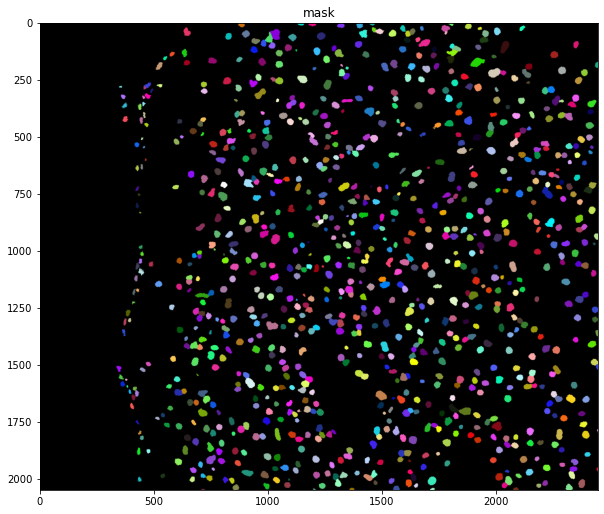

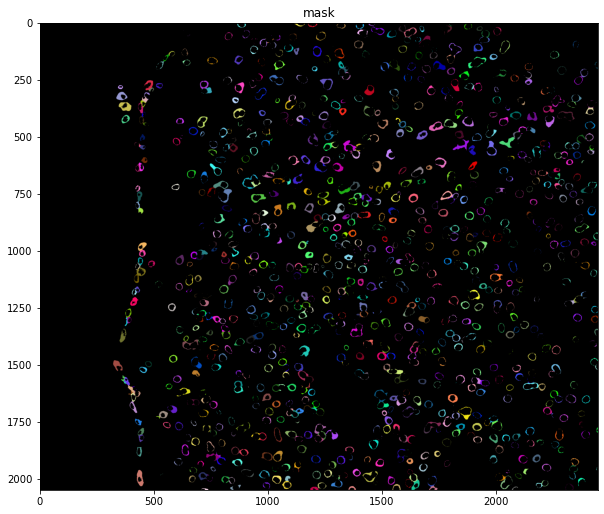

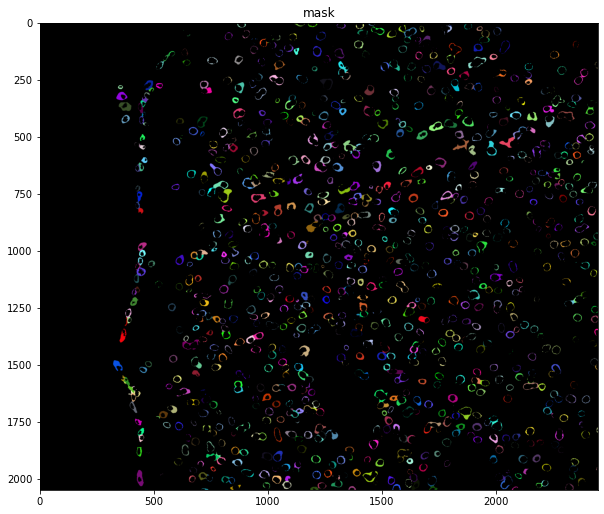

In [46]:
Display_mask(pos_class.nuclei_mask.numpy())
Display_mask(pos_class.cytoplasm_mask.numpy())
Display_mask(pos_class.total_mask.numpy())

In [18]:
""" Load data into merged annData """
fishdata = FISHData(os.path.join(metadata_path,'fishdata'))
data_list = []
for posname in posnames:
    data = fishdata.load_data('h5ad',dataset=dataset,posname=posname)
    if isinstance(data,anndata._core.anndata.AnnData):
        data_list.append(data)
data = anndata.concat(data_list)
data

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


AnnData object with n_obs × n_vars = 81902 × 24
    obs: 'label', 'pixel_x', 'pixel_y', 'nuclei_size', 'nuclei_signal', 'cyto_size', 'cyto_signal', 'total_size', 'total_signal', 'posname', 'posname_stage_x', 'posname_stage_y'
    layers: 'cytoplasm_vectors', 'nuclei_vectors', 'total_vectors'

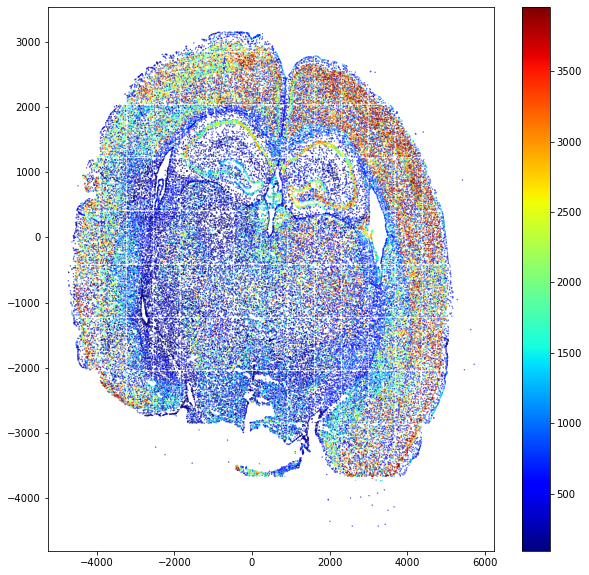

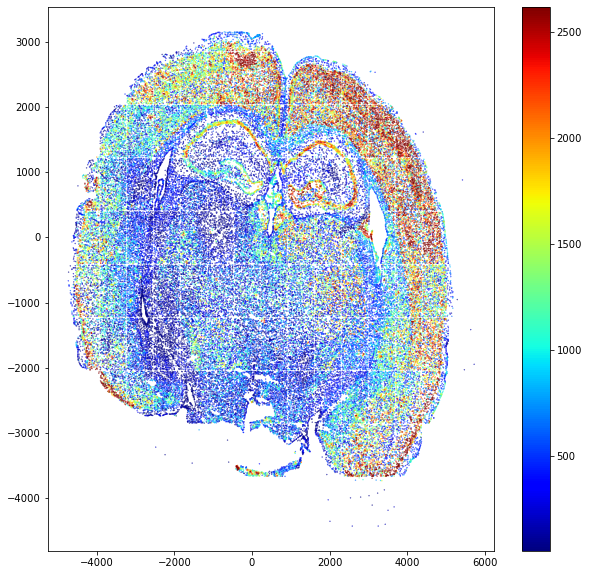

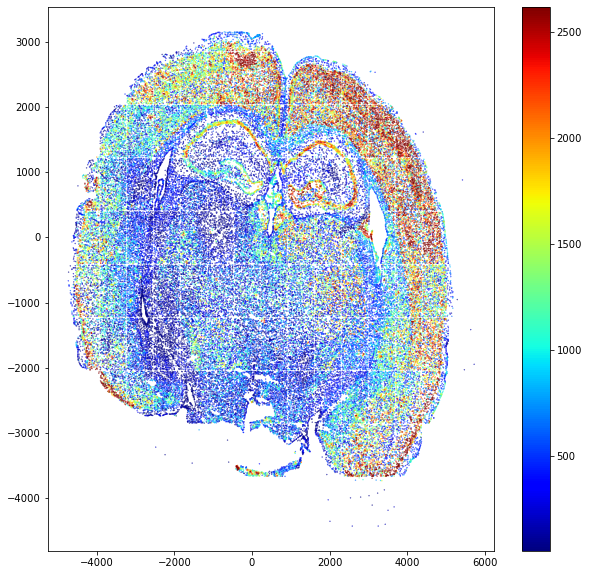

In [28]:
""" Update Stage Coordinates"""
pixel_size = 0.326
camera_direction = [-1,-1]
stage_x = np.array(data.obs['posname_stage_x']) + camera_direction[0]*pixel_size*np.array(data.obs['pixel_x'])
stage_y = np.array(data.obs['posname_stage_y']) + camera_direction[1]*pixel_size*np.array(data.obs['pixel_y'])
data.obs['stage_x'] = stage_x
data.obs['stage_y'] = stage_y
plt.figure(figsize=[10,10])
c = np.array(data.obs['nuclei_signal'])
plt.scatter(stage_x,-stage_y,s=0.1,c=c,vmax=np.percentile(c[np.isnan(c)==False],95),vmin=np.percentile(c[np.isnan(c)==False],5),cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=[10,10])
c = np.array(data.obs['cyto_signal'])
plt.scatter(stage_x,-stage_y,s=0.1,c=c,vmax=np.percentile(c[np.isnan(c)==False],95),vmin=np.percentile(c[np.isnan(c)==False],5),cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=[10,10])
c = np.array(data.obs['total_signal'])
plt.scatter(stage_x,-stage_y,s=0.1,c=c,vmax=np.percentile(c[np.isnan(c)==False],95),vmin=np.percentile(c[np.isnan(c)==False],5),cmap='jet')
plt.colorbar()
plt.show()

In [30]:
xy = np.zeros([data.shape[0],2])
xy[:,0] = data.obs['stage_x']
xy[:,1] = -data.obs['stage_y']
data.obsm['stage'] = xy

/home/zach/miniconda3/envs/pyfish_3.9/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'posname' as categorical


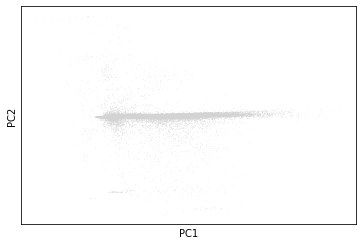

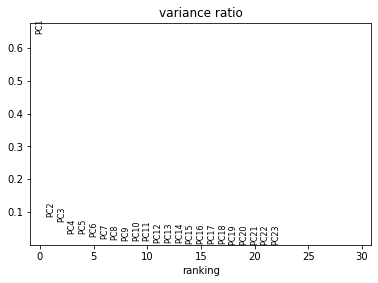

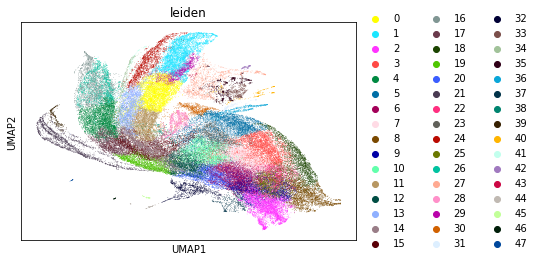

<Figure size 1800x1080 with 0 Axes>

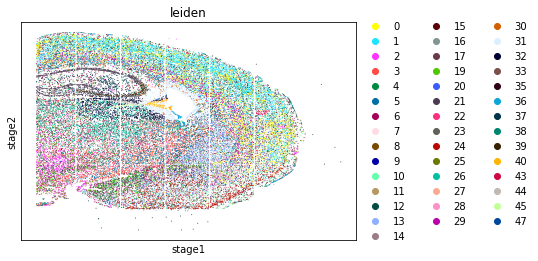

In [31]:
import scanpy as sc
sc.tl.pca(data, svd_solver='arpack')
sc.pl.pca(data)
sc.pl.pca_variance_ratio(data, log=False)
sc.pp.neighbors(data, n_neighbors=10, n_pcs=10)
sc.tl.leiden(data)
sc.tl.paga(data)
sc.pl.paga(data, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
sc.tl.umap(data, init_pos='paga')
sc.pl.umap(data, color=['leiden'])
data_right = data[data.obsm['stage'][:,0]>1000]
plt.figure(figsize=[25,15])
sc.pl.embedding(data_right,'stage', color=['leiden'])

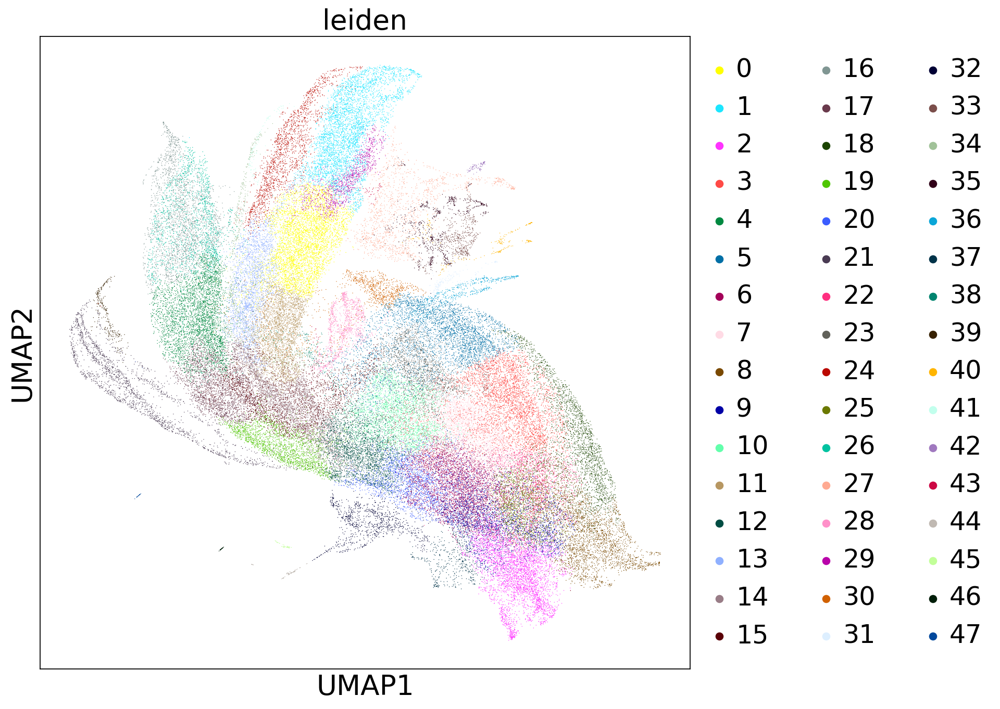

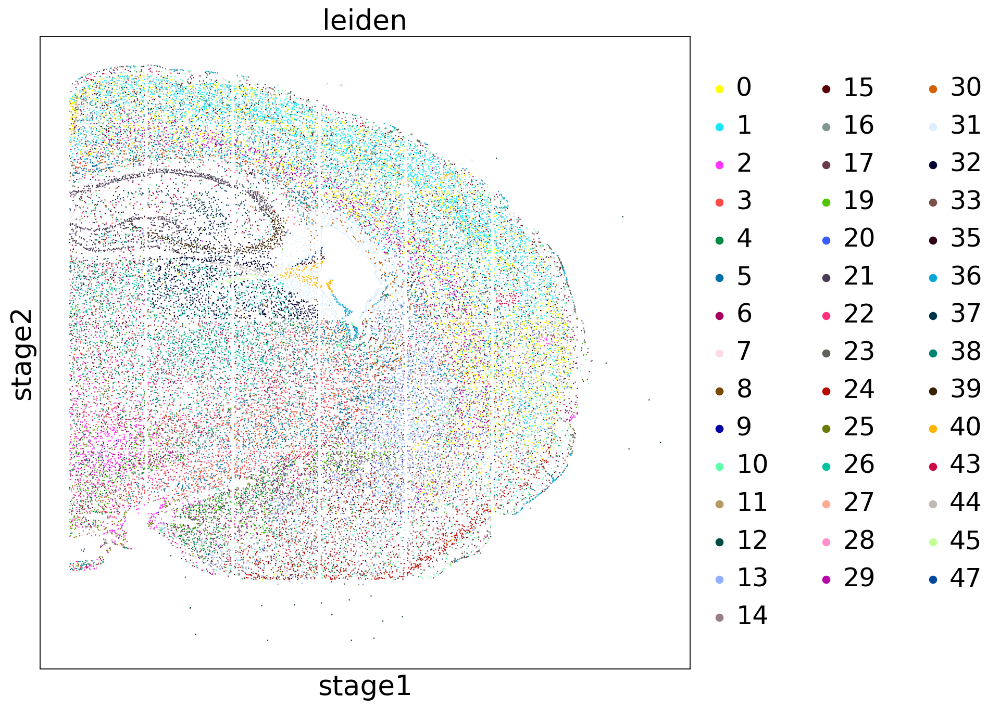

In [56]:
sc.set_figure_params(figsize=[10,10],fontsize=24)
sc.pl.umap(data, color=['leiden'])
data_right = data[data.obsm['stage'][:,0]>1000]
sc.pl.embedding(data_right,'stage', color=['leiden'],size=5)

In [57]:
""" Bitwise Correction Factor """
""" Move to Same Space """
""" Move Vectors to same space (Relative) """
from sklearn.preprocessing import normalize
def normalize_vector(v,thresh = 25):
    v = v.copy()
    v = v-np.percentile(v,50)
    v = v/(np.percentile(v,75)-np.percentile(v,25))
    return v
data.obs_names_make_unique()
data.layers['DPNMF'] = data.X.copy()
norm_measured = np.array(data.layers['DPNMF'].copy())
for i in range(norm_measured.shape[1]):
    """ Scale bitwise first """
    norm_measured[:,i] = normalize_vector(norm_measured[:,i])
    
data.layers['DPNMF_IQR'] = norm_measured.copy()

data.layers['DPNMF_L2'] = normalize(norm_measured.copy())


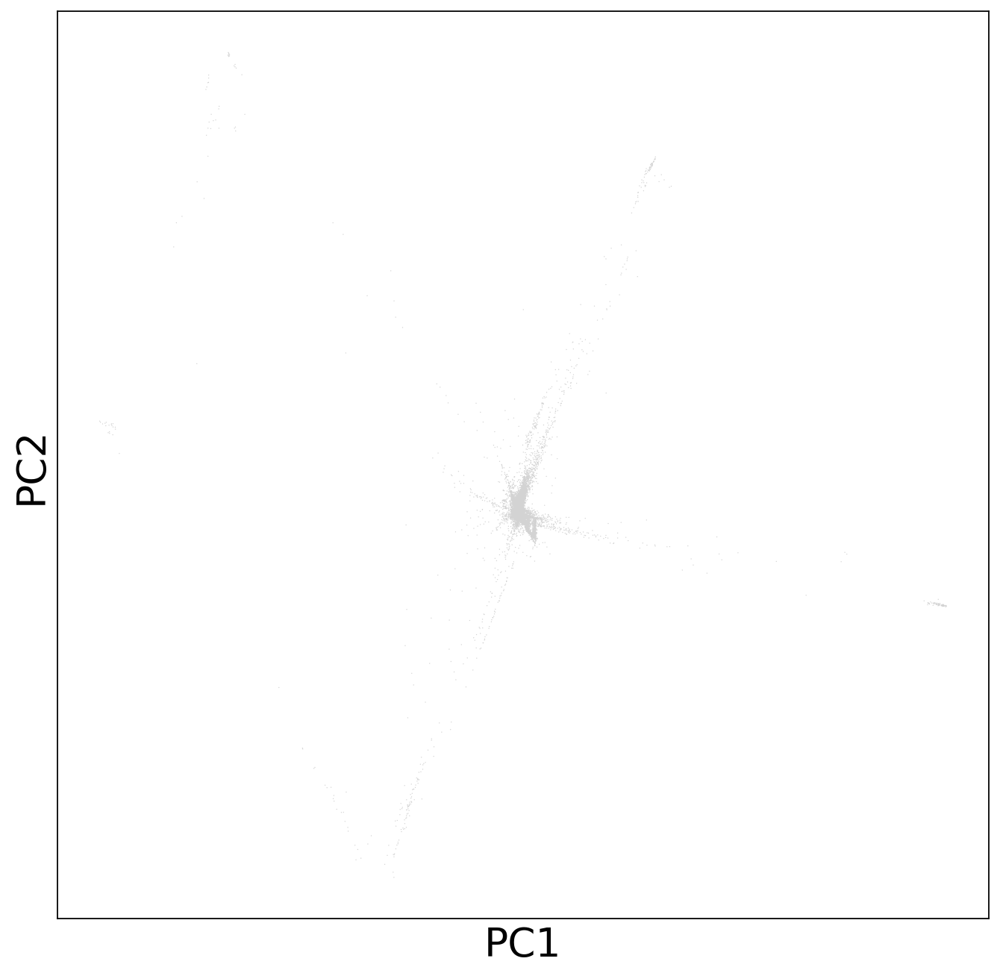

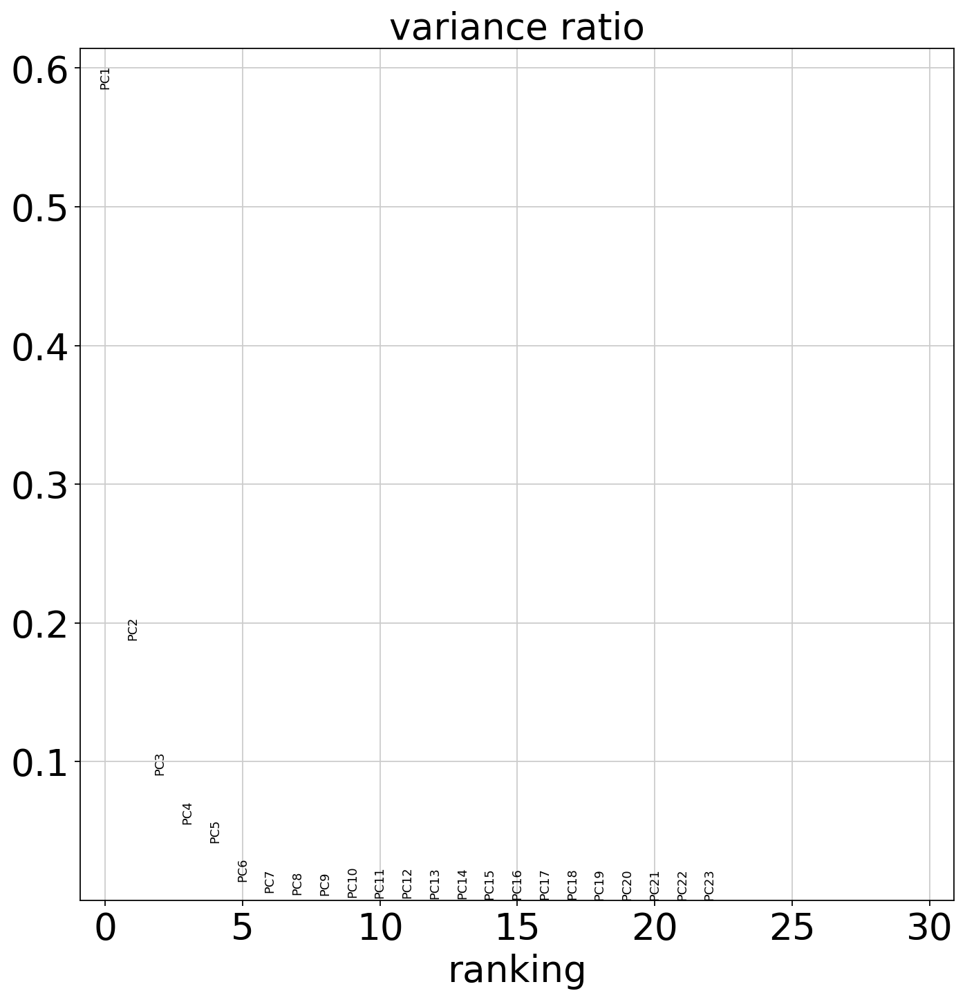

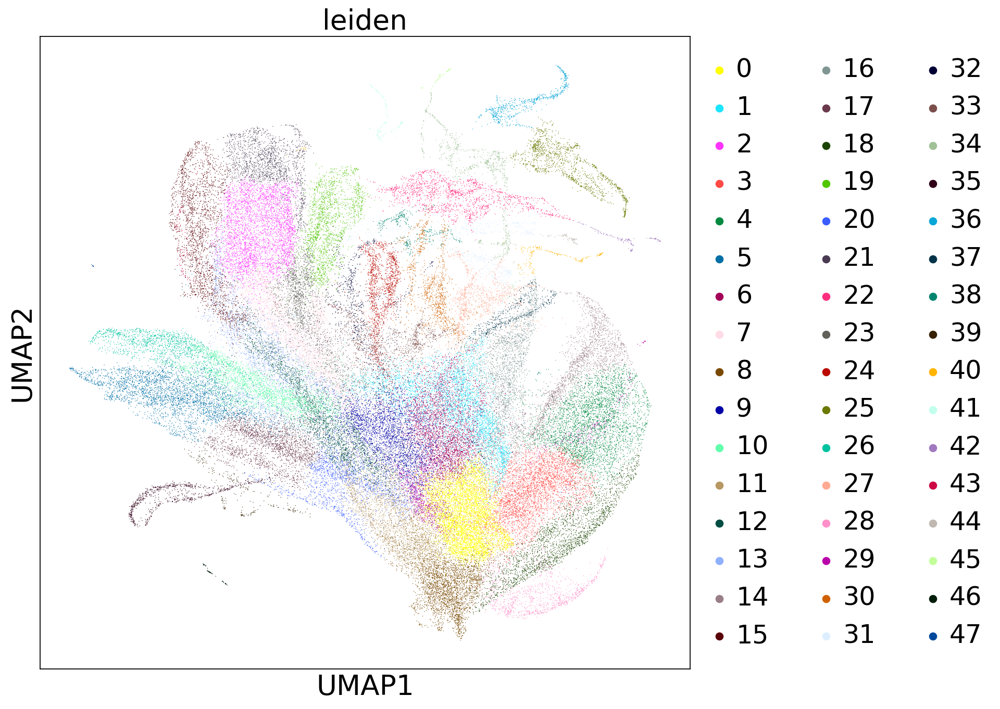

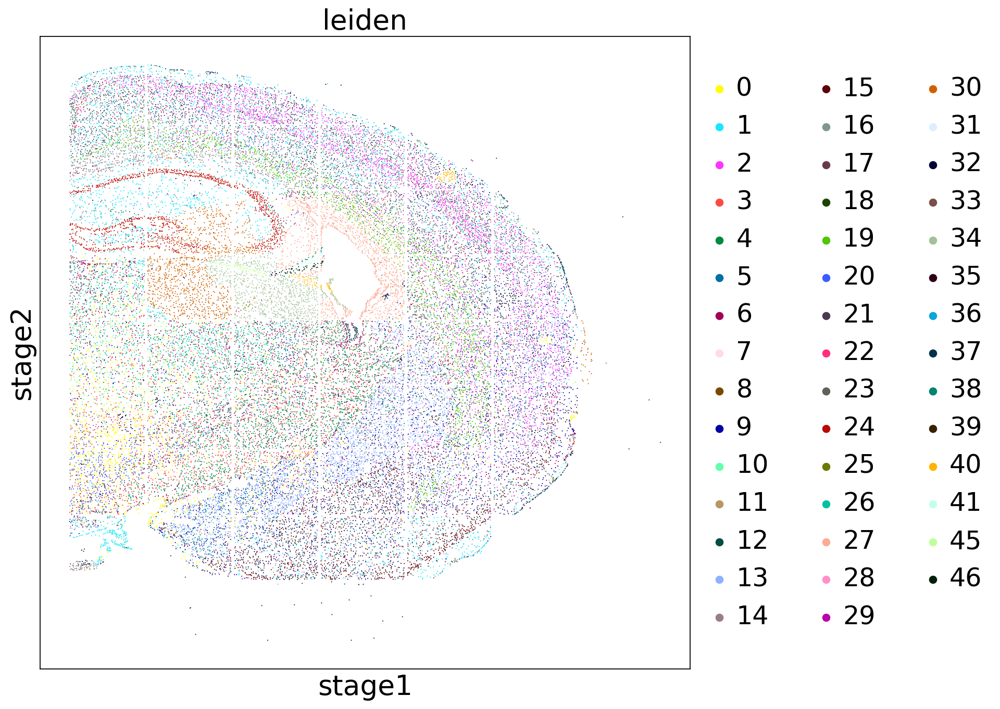

In [59]:

import scanpy as sc
data.X = data.layers['DPNMF_IQR']
sc.tl.pca(data, svd_solver='arpack')
sc.pl.pca(data)
sc.pl.pca_variance_ratio(data, log=False)
sc.pp.neighbors(data, n_neighbors=10, n_pcs=10)
sc.tl.leiden(data)
sc.tl.paga(data)
sc.pl.paga(data, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
sc.tl.umap(data, init_pos='paga')
sc.pl.umap(data, color=['leiden'])
data_right = data[data.obsm['stage'][:,0]>1000]
sc.pl.embedding(data_right,'stage', color=['leiden'])

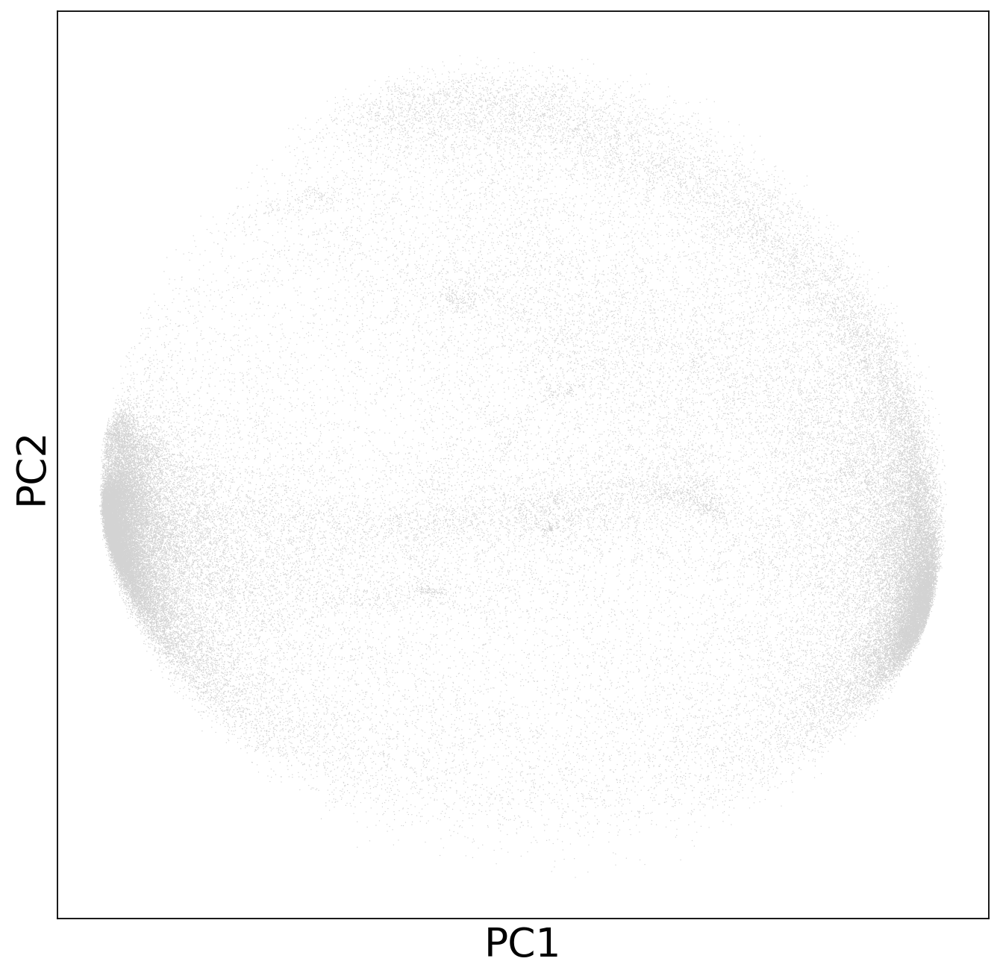

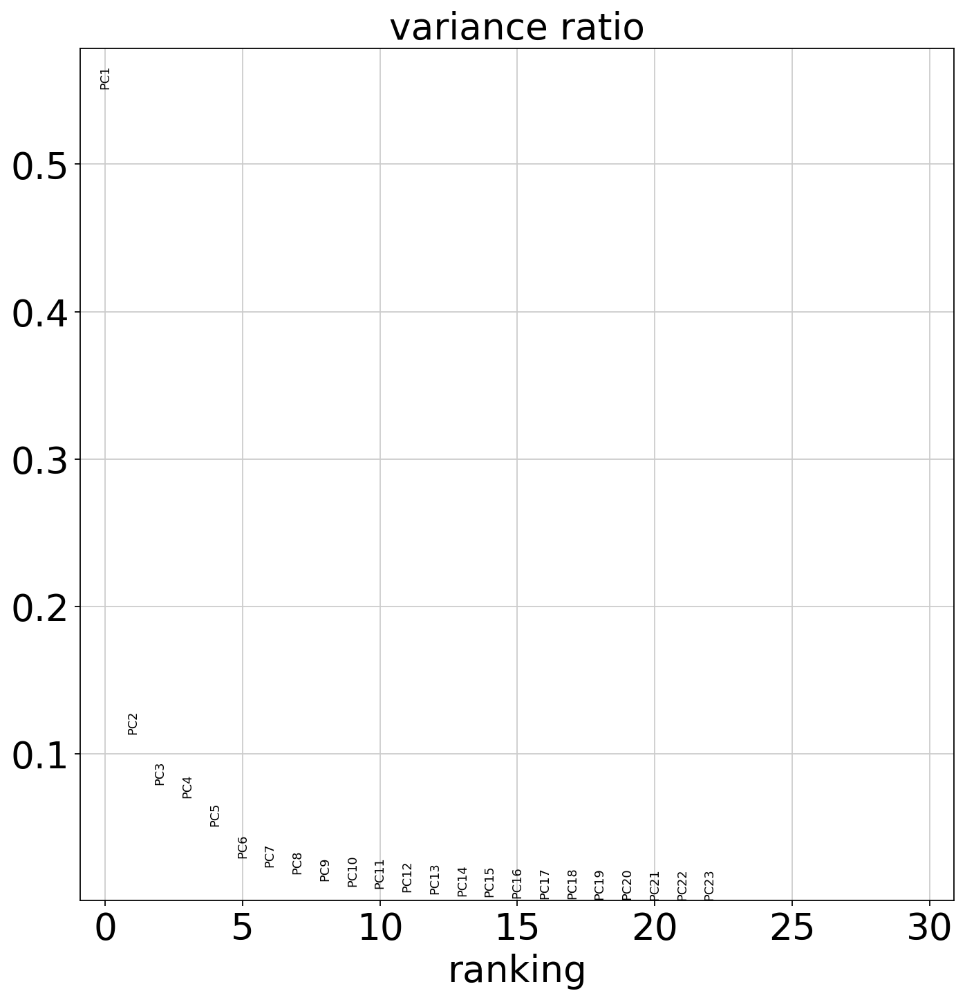

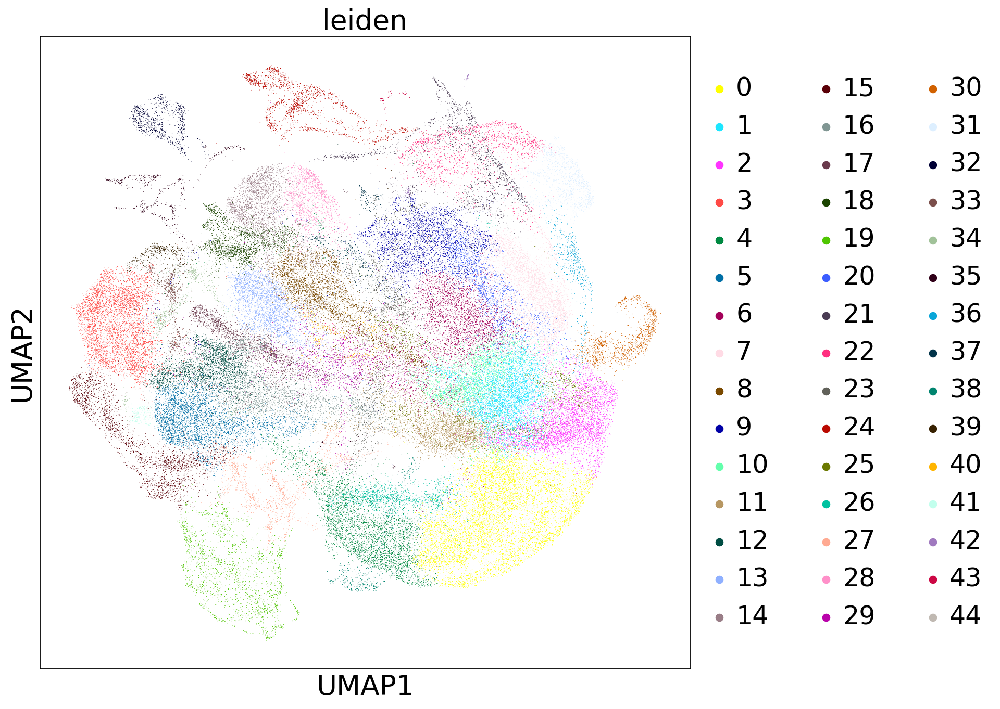

Trying to set attribute `.uns` of view, copying.


<Figure size 2000x1200 with 0 Axes>

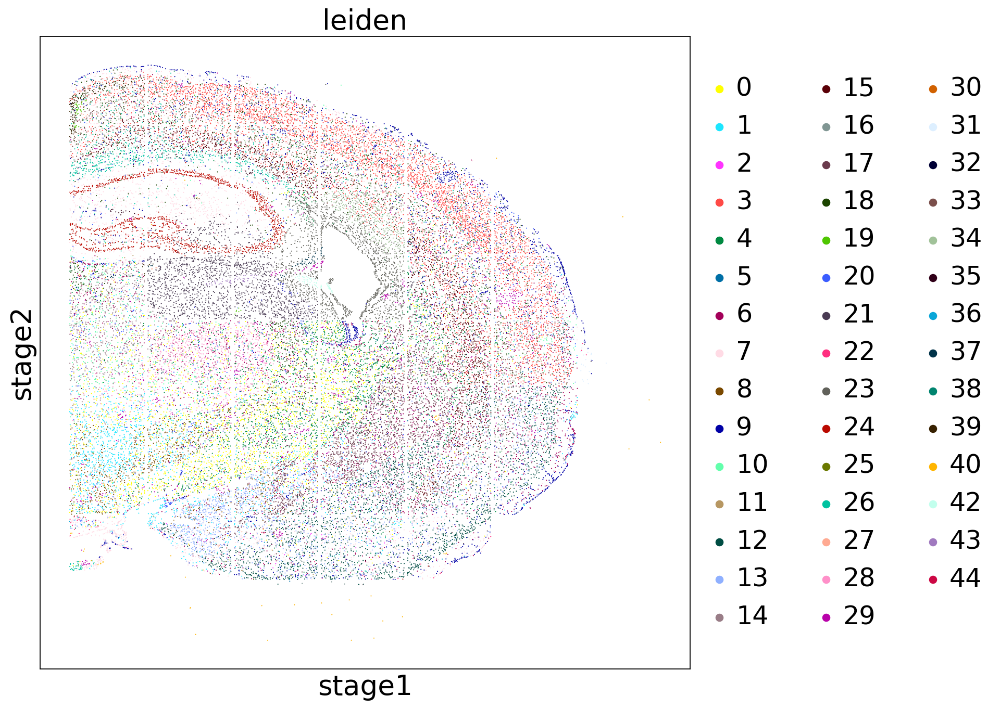

In [58]:

import scanpy as sc
data.X = data.layers['DPNMF_L2']
sc.tl.pca(data, svd_solver='arpack')
sc.pl.pca(data)
sc.pl.pca_variance_ratio(data, log=False)
sc.pp.neighbors(data, n_neighbors=10, n_pcs=10)
sc.tl.leiden(data)
sc.tl.paga(data)
sc.pl.paga(data, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
sc.tl.umap(data, init_pos='paga')
sc.pl.umap(data, color=['leiden'])
data_right = data[data.obsm['stage'][:,0]>1000]
sc.pl.embedding(data_right,'stage', color=['leiden'])

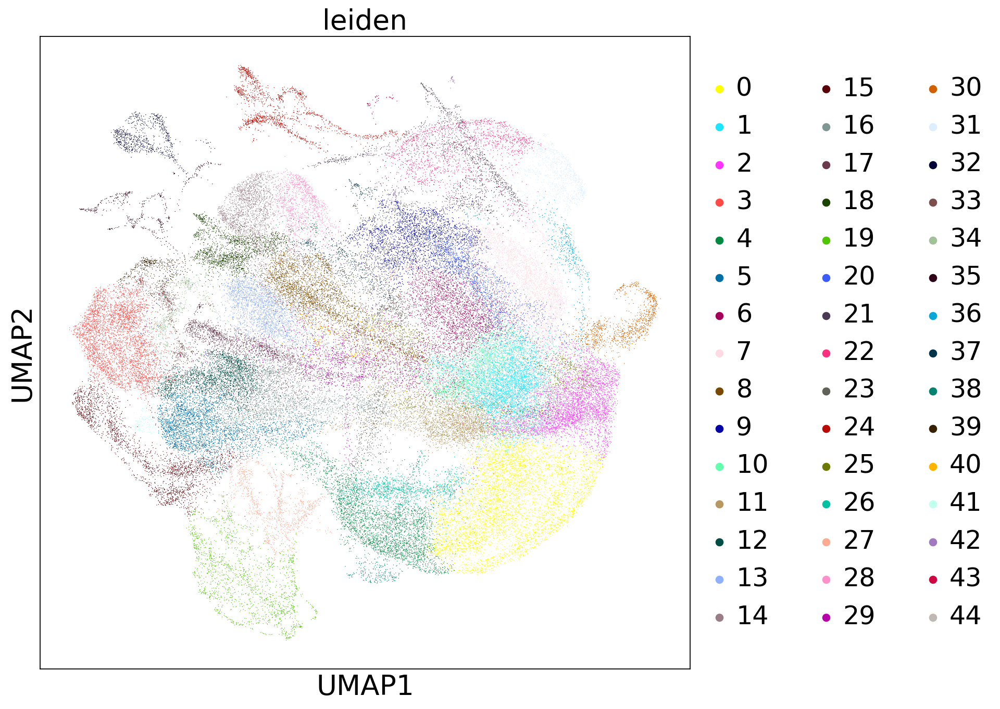

Trying to set attribute `.uns` of view, copying.


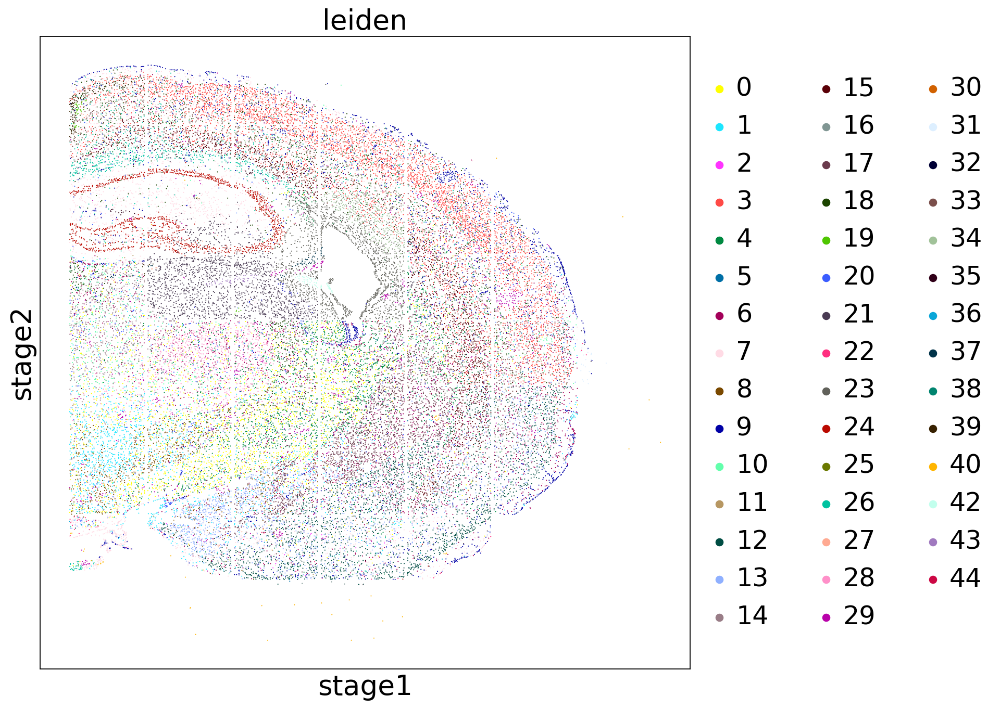

In [60]:
import scanpy as sc
data.X = data.layers['DPNMF_L2']
sc.pp.neighbors(data, n_neighbors=10, n_pcs=0)
sc.tl.leiden(data)
sc.tl.paga(data)
sc.pl.paga(data, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
sc.tl.umap(data, init_pos='paga')
sc.pl.umap(data, color=['leiden'])
data_right = data[data.obsm['stage'][:,0]>1000]
sc.pl.embedding(data_right,'stage', color=['leiden'])

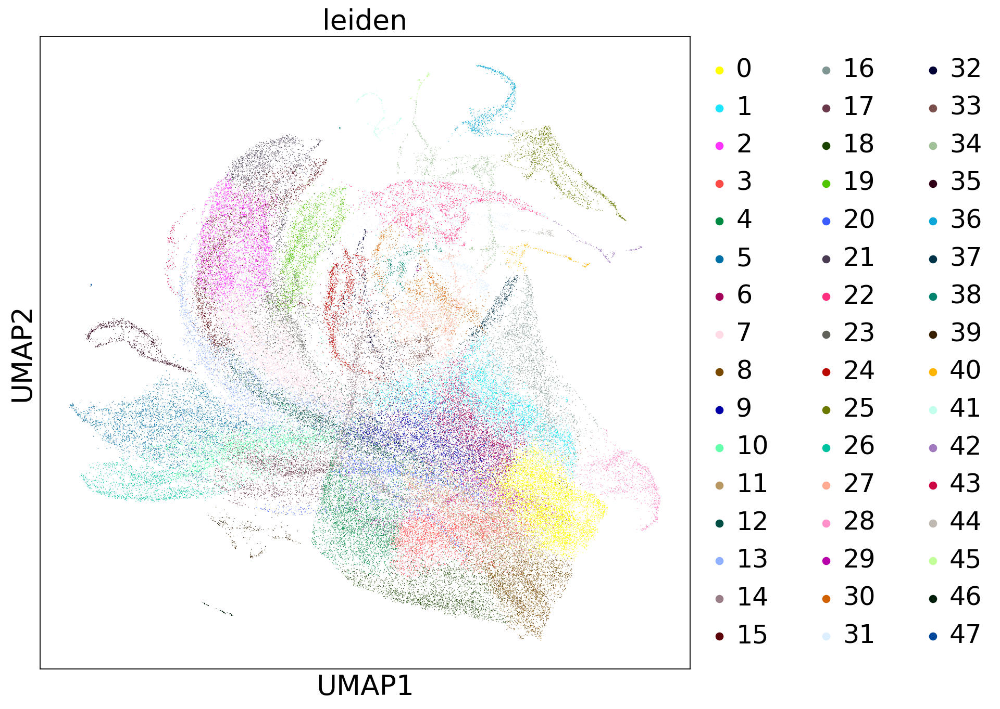

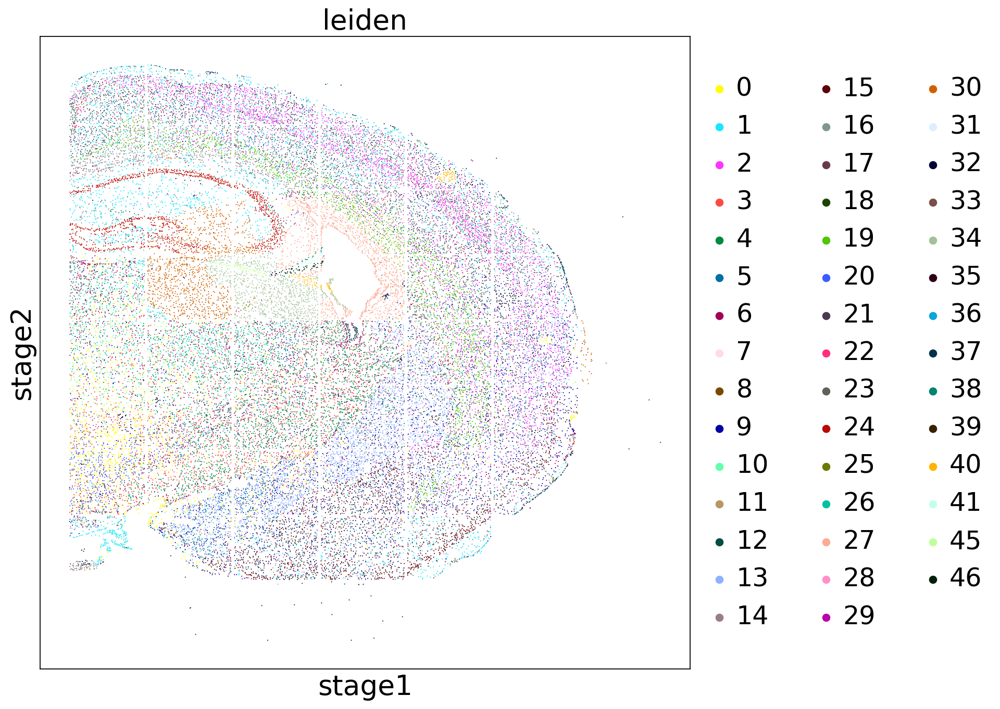

In [61]:
import scanpy as sc
data.X = data.layers['DPNMF_IQR']
sc.pp.neighbors(data, n_neighbors=10, n_pcs=0)
sc.tl.leiden(data)
sc.tl.paga(data)
sc.pl.paga(data, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
sc.tl.umap(data, init_pos='paga')
sc.pl.umap(data, color=['leiden'])
data_right = data[data.obsm['stage'][:,0]>1000]
sc.pl.embedding(data_right,'stage', color=['leiden'])